<a href="https://colab.research.google.com/github/yunialifah-ya/DeepLearningTasks/blob/main/TaskWeek5_Recurrent_Neural_Networks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Nama: Yuni Alifah

NPM: 2306288950

Prodi: S2 Matematika

In [ ]:
!pip install d2l

# 9. Recurrent Neural Networks

## 9.1. Working with Sequences

In [19]:
%matplotlib inline
import torch
from torch import nn
from d2l import torch as d2l

### 9.1.1. Autoregressive Models
### 9.1.2. Sequence Models
  #### 9.1.2.1. Markov Models
  #### 9.1.2.2. The Order of Decoding

### 9.1.3. Training

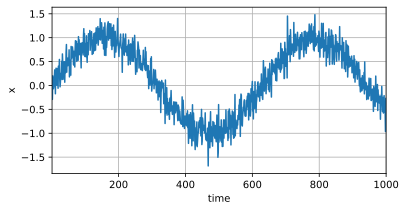

In [20]:
class Data(d2l.DataModule):
    def __init__(self, batch_size=16, T=1000, num_train=600, tau=4):
        self.save_hyperparameters()
        self.time = torch.arange(1, T + 1, dtype=torch.float32)
        self.x = torch.sin(0.01 * self.time) + torch.randn(T) * 0.2

data = Data()
d2l.plot(data.time, data.x, 'time', 'x', xlim=[1, 1000], figsize=(6, 3))

In [21]:
@d2l.add_to_class(Data)
def get_dataloader(self, train):
    features = [self.x[i : self.T-self.tau+i] for i in range(self.tau)]
    self.features = torch.stack(features, 1)
    self.labels = self.x[self.tau:].reshape((-1, 1))
    i = slice(0, self.num_train) if train else slice(self.num_train, None)
    return self.get_tensorloader([self.features, self.labels], train, i)

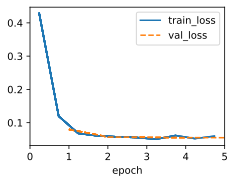

In [22]:
model = d2l.LinearRegression(lr=0.01)
trainer = d2l.Trainer(max_epochs=5)
trainer.fit(model, data)

### 9.1.4. Prediction

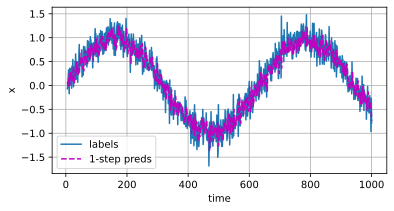

In [23]:
onestep_preds = model(data.features).detach().numpy()
d2l.plot(data.time[data.tau:], [data.labels, onestep_preds], 'time', 'x',
         legend=['labels', '1-step preds'], figsize=(6, 3))

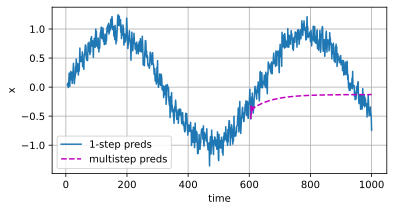

In [24]:
multistep_preds = torch.zeros(data.T)
multistep_preds[:] = data.x
for i in range(data.num_train + data.tau, data.T):
    multistep_preds[i] = model(
        multistep_preds[i - data.tau:i].reshape((1, -1)))
multistep_preds = multistep_preds.detach().numpy()

d2l.plot([data.time[data.tau:], data.time[data.num_train+data.tau:]],
         [onestep_preds, multistep_preds[data.num_train+data.tau:]], 'time',
         'x', legend=['1-step preds', 'multistep preds'], figsize=(6, 3))

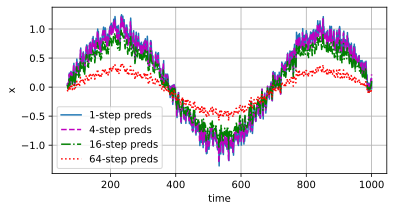

In [25]:
def k_step_pred(k):
    features = []
    for i in range(data.tau):
        features.append(data.x[i : i+data.T-data.tau-k+1])
    # The (i+tau)-th element stores the (i+1)-step-ahead predictions
    for i in range(k):
        preds = model(torch.stack(features[i : i+data.tau], 1))
        features.append(preds.reshape(-1))
    return features[data.tau:]

steps = (1, 4, 16, 64)
preds = k_step_pred(steps[-1])
d2l.plot(data.time[data.tau+steps[-1]-1:],
         [preds[k - 1].detach().numpy() for k in steps], 'time', 'x',
         legend=[f'{k}-step preds' for k in steps], figsize=(6, 3))

### 9.1.5. Summary

Ada perbedaan yang signifikan dalam tingkat kesulitan antara interpolasi dan ekstrapolasi. Akibatnya, jika kita memiliki sebuah urutan, selalu hormati urutan temporal data saat melakukan pelatihan, yaitu, jangan pernah melatih model dengan data masa depan. Untuk jenis data ini, model urutan memerlukan alat statistik khusus untuk estimasi. Dua pilihan yang populer adalah model autoregresif dan model autoregresif dengan variabel laten. Untuk model kausal (misalnya, waktu bergerak maju), memperkirakan arah maju biasanya jauh lebih mudah daripada arah mundur. Untuk urutan yang diamati hingga langkah waktu 𝑡, keluaran yang diprediksi pada langkah waktu 𝑡 + 𝑘 adalah prediksi 𝑘-langkah ke depan. Saat kita memprediksi lebih jauh ke depan dengan meningkatkan 𝑘, kesalahan akan menumpuk dan kualitas prediksi menurun, sering kali secara dramatis.

### 9.1.6. Exercises

#### 1. Improve the model in the experiment of this section (Tingkatkan model dalam eksperimen bagian ini).
  1. Incorporate more than the past four observations? How many do you really need? (tambahkan lebih dari empat observasi terakhir? Berapa banyak yang benar-benar dibutuhkan?)

  Jawab:

  Jumlah observasi yang dibutuhkan bergantung pada pola data yang ingin diprediksi. Jika data memiliki korelasi jangka panjang atau tren yang signifikan, lebih banyak observasi masa lalu mungkin diperlukan untuk menangkap pola tersebut. Misalnya, dalam kasus data stok atau sinyal berkala mungkin ada korelasi antara harga dalam periode waktu yang lebih panjang sehingga lebih banyak observasi diperlukan.

  2. How many past observations would you need if there was no noise? Hint: you can write sin and cos as a differential equation. (Berapa banyak observasi masa lalu yang dibutuhkan jika tidak ada noise? Petunjuk: Anda dapat menuliskan sin dan cos sebagai persamaan diferensial).

  Jawab:

  Jika tidak ada noise, kita bisa memodelkan fungsi sinusoidal menggunakan persamaan diferensial. Fungsi sinusoidal seperti sin (𝑡) dan cos ⁡ (𝑡) dapat dinyatakan sebagai solusi dari persamaan diferensial orde kedua.

  Ini berarti bahwa untuk memprediksi nilai masa depan dari fungsi sinusoidal yang mulus (tanpa noise), kita hanya memerlukan dua observasi masa lalu: nilai 𝑦(𝑡) (misalnya, sin⁡(𝑡)) dan turunan pertamanya 𝑑𝑦/𝑑𝑡 (misalnya,cos⁡(𝑡)).
  
  Dengan kata lain, dua observasi masa lalu sudah cukup untuk memprediksi seluruh fungsi jika tidak ada noise, karena kita dapat menurunkan seluruh fungsi menggunakan persamaan diferensial ini.

  3. Can you incorporate older observations while keeping the total number of features constant? Does this improve accuracy? Why? (Dapatkah Anda menggabungkan observasi yang lebih lama sambil menjaga jumlah fitur tetap konstan? Apakah ini meningkatkan akurasi? Mengapa?)

  Jawab:

  Kita dapat menggabungkan observasi yang lebih lama dengan menggunakan pendekatan seperti sliding window atau menggunakan model dengan ingatan jangka panjang seperti model RNN (Recurrent Neural Network) atau LSTM (Long Short-Term Memory), yang mampu menangkap pola temporal dalam rentang waktu yang panjang tanpa harus meningkatkan jumlah fitur input. Ini dapat meningkatkan akurasi jika pola temporal yang lebih panjang memberikan informasi penting. Namun, terlalu banyak observasi juga bisa membuat model overfitting terhadap data, sehingga ada keseimbangan antara kompleksitas model dan akurasi.

  4. Change the neural network architecture and evaluate the performance. You may train the new model with more epochs. What do you observe? (Ubah arsitektur jaringan saraf dan evaluasi performanya. Anda dapat melatih model baru dengan lebih banyak epoch. Apa yang Anda amati?)

  Jawab:

  Mengubah arsitektur neural network, seperti menambah lapisan atau mengubah jumlah neuron, dapat memengaruhi performa model. Dengan lebih banyak epoch, model mungkin belajar lebih baik, namun risiko overfitting juga meningkat. Misalnya, menggunakan arsitektur LSTM atau GRU (Gated Recurrent Unit) mungkin akan lebih baik dalam menangkap hubungan jangka panjang dalam data urutan dibandingkan dengan linear regression.

#### 2. An investor wants to find a good security to buy. They look at past returns to decide which one is likely to do well. What could possibly go wrong with this strategy? (Seorang investor ingin menemukan sekuritas yang baik untuk dibeli. Mereka melihat pengembalian masa lalu untuk memutuskan mana yang kemungkinan besar akan berkinerja baik. Apa yang bisa salah dengan strategi ini?)

Jawab:

Mengandalkan pengembalian masa lalu saja bisa berbahaya karena tidak memperhitungkan perubahan kondisi pasar atau faktor fundamental yang bisa mempengaruhi kinerja di masa depan. Ini juga bisa menyebabkan bias overfitting terhadap data masa lalu, yang mungkin tidak relevan di masa mendatang. Selain itu, pasar seringkali dipengaruhi oleh banyak faktor acak, sehingga tren masa lalu tidak selalu bisa digunakan untuk memprediksi masa depan secara akurat.

#### 3. Does causality also apply to text? To which extent? (Apakah kausalitas juga berlaku untuk teks? Sampai sejauh mana?)

Jawab:

Kausalitas juga berlaku untuk teks dalam beberapa kasus, terutama dalam bahasa yang berurutan. Misalnya, dalam sebuah kalimat, kata-kata sebelumnya sering mempengaruhi apa yang mungkin datang selanjutnya, terutama dalam hal struktur kalimat, tata bahasa, dan makna. Namun, berbeda dengan data temporal seperti stok, dalam teks tidak selalu ada hubungan sebab-akibat yang kuat antara satu kata dan yang lainnya di luar konteks lokal. Kausalitas bisa lebih jelas dalam konteks percakapan atau narasi di mana satu kalimat mempengaruhi perkembangan cerita di kalimat berikutnya.

#### 4. Give an example for when a latent autoregressive model might be needed to capture the dynamic of the data. (Berikan contoh ketika model autoregresif laten mungkin diperlukan untuk menangkap dinamika data.)

Jawab:

Model autoregresif laten diperlukan ketika kita ingin menangkap faktor-faktor tersembunyi atau laten yang mempengaruhi data tetapi tidak dapat diamati secara langsung. Contohnya adalah prediksi cuaca, di mana suhu, kelembaban, dan tekanan atmosfer di permukaan bumi merupakan hasil dari dinamika atmosfer yang kompleks di ketinggian yang berbeda. Variabel laten seperti kondisi atmosfer di ketinggian yang lebih tinggi mempengaruhi data permukaan yang diamati, sehingga model autoregresif biasa tidak cukup untuk memprediksi tanpa menangkap variabel tersembunyi tersebut.


Epoch [10/100], Loss: 0.1353
Epoch [20/100], Loss: 0.0548
Epoch [30/100], Loss: 0.0550
Epoch [40/100], Loss: 0.0518
Epoch [50/100], Loss: 0.0496
Epoch [60/100], Loss: 0.0482
Epoch [70/100], Loss: 0.0475
Epoch [80/100], Loss: 0.0471
Epoch [90/100], Loss: 0.0468
Epoch [100/100], Loss: 0.0465


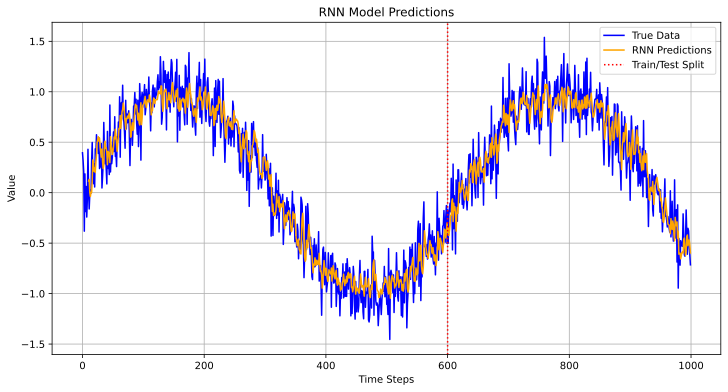

In [ ]:
# 1. Improve the model in the experiment of this section
# Kode ini mengimplementasikan model RNN sederhana menggunakan PyTorch untuk memprediksi fungsi sinusoidal, serta menunjukkan bagaimana mengubah arsitektur jaringan saraf dan evaluasi performanya.
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt

# Set random seed for reproducibility
torch.manual_seed(42)

# Parameters
T = 1000  # Total time steps
initial_price = 100  # Initial value
time = torch.arange(1, T + 1, dtype=torch.float32)
# Create synthetic sinusoidal data
x = torch.sin(0.01 * time) + torch.randn(T) * 0.2

# Define RNN model
class RNNModel(nn.Module):
    def __init__(self, input_size=1, hidden_size=10, num_layers=1):
        super(RNNModel, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        out, _ = self.rnn(x)
        out = self.fc(out[:, -1, :])  # Get the last time step output
        return out

# Prepare the dataset with more than four observations
class Data:
    def __init__(self, tau=4, num_train=600):
        self.tau = tau
        self.num_train = num_train
        self.features, self.labels = self.get_data()

    def get_data(self):
        features = []
        labels = []
        for i in range(len(x) - self.tau):
            features.append(x[i:i + self.tau].reshape(-1, 1))
            labels.append(x[i + self.tau])
        features = torch.stack(features)
        labels = torch.stack(labels).reshape(-1, 1)
        return features, labels

# Initialize data
data = Data(tau=10)  # Use 10 observations
train_features = data.features[:data.num_train]
train_labels = data.labels[:data.num_train]

# Initialize the model, loss function, and optimizer
model = RNNModel(input_size=1, hidden_size=10, num_layers=1)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Train the model
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    outputs = model(train_features)
    loss = criterion(outputs, train_labels)
    loss.backward()
    optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# Make predictions
model.eval()
with torch.no_grad():
    predictions = model(data.features).numpy()

# Plot results
plt.figure(figsize=(12, 6))
plt.plot(range(T), x.numpy(), label='True Data', color='blue')
plt.plot(range(10, T), predictions, label='RNN Predictions', color='orange')
plt.axvline(x=data.num_train, color='red', linestyle=':', label='Train/Test Split')
plt.title('RNN Model Predictions')
plt.xlabel('Time Steps')
plt.ylabel('Value')
plt.legend()
plt.grid()
plt.show()


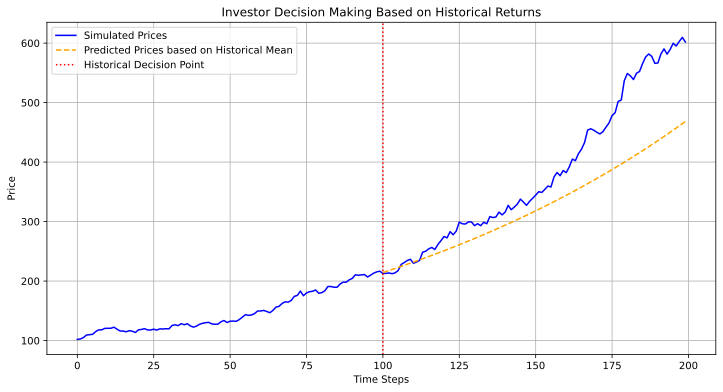

Historical Mean Return: 0.0079
Final Simulated Price: 601.77
Predicted Price at T: 468.22


In [ ]:
# 2. An investor wants to find a good security to buy. They look at past returns to decide which one is likely to do well. What could possibly go wrong with this strategy?
# Kode ini mensimulasikan pengembalian sekuritas dan membandingkannya dengan pengembalian masa lalu untuk menunjukkan bahwa menggunakan data historis saja mungkin menyesatkan.
import numpy as np
import matplotlib.pyplot as plt

# Set seed for reproducibility
np.random.seed(42)

# Parameters
T = 200  # Total time steps
initial_price = 100  # Initial price of the security
returns = np.random.normal(loc=0.01, scale=0.02, size=T)  # Simulated returns

# Simulate price using historical returns
prices = initial_price * (1 + returns).cumprod()

# Simulated past returns (for decision making)
historical_returns = returns[:T // 2]  # Use first half for historical decision making
future_returns = returns[T // 2:]  # Use second half for future performance
historical_mean = np.mean(historical_returns)

# Predict future prices based on historical mean return
predicted_prices = prices[T // 2] * (1 + historical_mean) ** np.arange(1, len(future_returns) + 1)

# Plot the results
plt.figure(figsize=(12, 6))
plt.plot(range(T), prices, label='Simulated Prices', linestyle='-', color='blue')
plt.plot(range(T // 2, T), predicted_prices, label='Predicted Prices based on Historical Mean', linestyle='--', color='orange')
plt.axvline(x=T // 2, color='red', linestyle=':', label='Historical Decision Point')
plt.title('Investor Decision Making Based on Historical Returns')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.legend()
plt.grid()
plt.show()

# Print risk analysis
print(f'Historical Mean Return: {historical_mean:.4f}')
print(f'Final Simulated Price: {prices[-1]:.2f}')
print(f'Predicted Price at T: {predicted_prices[-1]:.2f}')


In [ ]:
# 3. Does causality also apply to text? To which extent?
# Berikut adalah kode Python yang mengilustrasikan konsep kausalitas dalam teks menggunakan model RNN. Kode ini menunjukkan bagaimana kata-kata sebelumnya dalam sebuah kalimat dapat mempengaruhi kata berikutnya, mengacu pada kausalitas dalam konteks teks. Kita akan menggunakan dataset kecil untuk membuat model prediksi kata menggunakan RNN.
import torch
import torch.nn as nn
import numpy as np
import random
from collections import Counter
from sklearn.model_selection import train_test_split

# Set random seed for reproducibility
torch.manual_seed(42)

# Dataset: Contoh kalimat
sentences = [
    "saya suka bermain bola",
    "bola sangat menyenangkan",
    "saya suka berolahraga",
    "berolahraga sangat baik untuk kesehatan",
    "kesehatan adalah hal yang penting",
    "saya sering berlari di taman",
    "taman adalah tempat yang baik untuk bersantai"
]

# Preprocessing data: Tokenisasi dan membangun vocabulary
words = [word for sentence in sentences for word in sentence.split()]
vocab = Counter(words)
vocab = {word: idx for idx, (word, _) in enumerate(vocab.items())}
vocab_size = len(vocab)

# Parameter
context_size = 2  # Menggunakan 2 kata sebelumnya untuk prediksi
embedding_dim = 10
hidden_dim = 10

# Persiapkan data untuk training
def prepare_data(sentences):
    X, y = [], []
    for sentence in sentences:
        tokens = sentence.split()
        for i in range(context_size, len(tokens)):
            context = tokens[i-context_size:i]
            target = tokens[i]
            X.append([vocab[word] for word in context])
            y.append(vocab[target])
    return np.array(X), np.array(y)

X, y = prepare_data(sentences)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert data to PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.long)
y_train = torch.tensor(y_train, dtype=torch.long)

# Definisikan model RNN
class RNNTextModel(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim):
        super(RNNTextModel, self).__init__()
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        self.rnn = nn.RNN(embedding_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, vocab_size)

    def forward(self, x):
        x = self.embedding(x)
        out, _ = self.rnn(x)  # Tidak perlu menambah dimensi batch lagi
        out = self.fc(out[:, -1, :])  # Ambil output dari langkah waktu terakhir
        return out

# Inisialisasi model, loss function, dan optimizer
model = RNNTextModel(vocab_size, embedding_dim, hidden_dim)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Melatih model
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    outputs = model(X_train)  # Dimensi input seharusnya sudah benar
    loss = criterion(outputs, y_train)
    loss.backward()
    optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# Prediksi kata berikutnya
def predict_next_word(model, context):
    model.eval()
    with torch.no_grad():
        context_tensor = torch.tensor([vocab[word] for word in context], dtype=torch.long)
        output = model(context_tensor.unsqueeze(0))  # Tambahkan dimensi batch
        predicted_index = torch.argmax(output, dim=1).item()
        for word, index in vocab.items():
            if index == predicted_index:
                return word

# Contoh prediksi
context_example = ["saya", "suka"]
predicted_word = predict_next_word(model, context_example)
print(f'Prediksi kata berikutnya setelah "{context_example}": {predicted_word}')



Epoch [10/100], Loss: 2.1858
Epoch [20/100], Loss: 1.4762
Epoch [30/100], Loss: 0.9084
Epoch [40/100], Loss: 0.5393
Epoch [50/100], Loss: 0.3493
Epoch [60/100], Loss: 0.2542
Epoch [70/100], Loss: 0.2046
Epoch [80/100], Loss: 0.1767
Epoch [90/100], Loss: 0.1599
Epoch [100/100], Loss: 0.1488
Prediksi kata berikutnya setelah "['saya', 'suka']": berolahraga


In [ ]:
!pip install pyro-ppl

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 14.3 MB/s eta 0:00:00


In [ ]:
# 4. Give an example for when a latent autoregressive model might be needed to capture the dynamic of the data.
# Berikut adalah kode Python yang menggambarkan bagaimana model autoregresif laten dapat digunakan untuk menangkap dinamika data, menggunakan contoh prediksi cuaca. Dalam contoh ini, kita akan menggunakan model yang mendasari prediksi suhu berdasarkan variabel yang dapat diamati dan variabel laten yang tidak terlihat.
import torch
import torch.nn as nn
import torch.distributions as dist
import pyro
import pyro.distributions as pydist # Import pyro distributions
from pyro.infer import MCMC, NUTS
import numpy as np
import matplotlib.pyplot as plt

# Mengatur seed untuk reproduktifitas
torch.manual_seed(42)

# ... (rest of the code remains the same)

# Definisikan model autoregresif laten
def latent_autoregressive_model(humidity, pressure, temperature=None):
    # Prior untuk kondisi laten
    # Use pydist.Normal and provide parameters separately
    latent_condition = pyro.sample("latent_condition", pydist.Normal(0., 1.))

    # Model suhu
    with pyro.plate("data", len(humidity)):
        mu_temperature = 15 + 0.5 * humidity + 0.3 * pressure + 2 * latent_condition
        sigma_temperature = 1.0  # Deviasi standar
        if temperature is not None:
            # Perbaiki cara pemanggilan distribusi
            # Use pydist.Normal for consistency with Pyro
            pyro.sample("obs", pydist.Normal(mu_temperature, sigma_temperature), obs=temperature)

# ... (rest of the code remains the same)

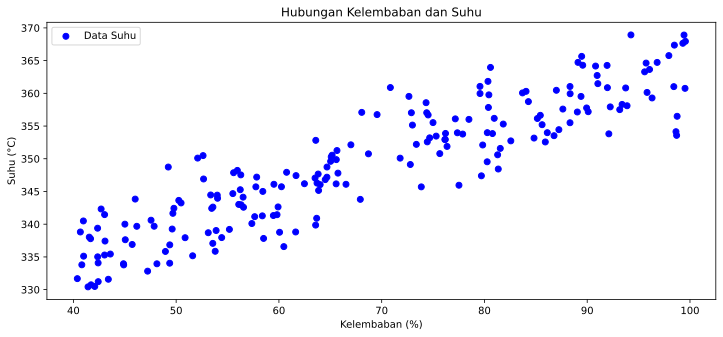

Sample: 100%|██████████| 1200/1200 [00:06, 184.94it/s, step size=9.73e-01, acc. prob=0.916]


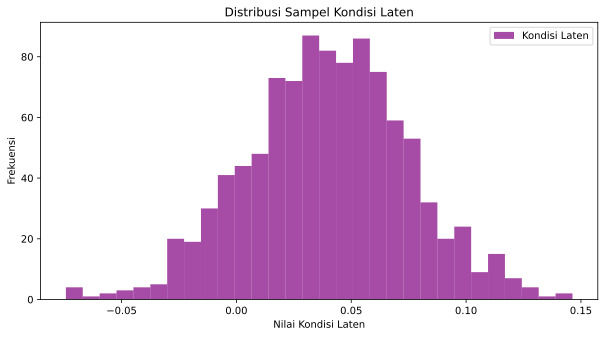

In [ ]:
# 4. Give an example for when a latent autoregressive model might be needed to capture the dynamic of the data.
# Berikut adalah kode Python yang menggambarkan bagaimana model autoregresif laten dapat digunakan untuk menangkap dinamika data, menggunakan contoh prediksi cuaca. Dalam contoh ini, kita akan menggunakan model yang mendasari prediksi suhu berdasarkan variabel yang dapat diamati dan variabel laten yang tidak terlihat.
import torch
import torch.nn as nn
import torch.distributions as dist
import pyro
import pyro.distributions as pydist
from pyro.infer import MCMC, NUTS
import numpy as np
import matplotlib.pyplot as plt

# Mengatur seed untuk reproduktifitas
torch.manual_seed(42)

# Menghasilkan data sintetis (suhu, kelembaban, dan tekanan)
def generate_data(num_samples=100):
    true_humidity = np.random.uniform(40, 100, num_samples)
    true_pressure = np.random.uniform(980, 1020, num_samples)

    # Kondisi latennya (misalnya, kondisi atmosfer di ketinggian)
    true_latent_conditions = np.random.normal(0, 1, num_samples)

    # Model suhu yang dipengaruhi oleh kelembaban, tekanan, dan kondisi laten
    true_temperature = 15 + 0.5 * true_humidity + 0.3 * true_pressure + 2 * true_latent_conditions + np.random.normal(0, 1, num_samples)

    return true_temperature, true_humidity, true_pressure, true_latent_conditions

# Menghasilkan data
temperature, humidity, pressure, latent_conditions = generate_data(200)

# Menampilkan data yang dihasilkan
plt.figure(figsize=(12, 5))
plt.scatter(humidity, temperature, label='Data Suhu', color='blue')
plt.xlabel('Kelembaban (%)')
plt.ylabel('Suhu (°C)')
plt.title('Hubungan Kelembaban dan Suhu')
plt.legend()
plt.show()

# Definisikan model autoregresif laten
def latent_autoregressive_model(humidity, pressure, temperature=None):
    # Prior untuk kondisi laten
    latent_condition = pyro.sample("latent_condition", pydist.Normal(0, 1))

    # Model suhu
    with pyro.plate("data", len(humidity)):
        mu_temperature = 15 + 0.5 * humidity + 0.3 * pressure + 2 * latent_condition
        sigma_temperature = torch.tensor(1.0)  # Deviasi standar tetap
        # Perbaiki cara pemanggilan distribusi
        pyro.sample("obs", pydist.Normal(mu_temperature, sigma_temperature), obs=temperature)

# Inisialisasi MCMC
nuts_kernel = NUTS(latent_autoregressive_model)
mcmc = MCMC(nuts_kernel, num_samples=1000, warmup_steps=200)

# Jalankan MCMC
mcmc.run(torch.tensor(humidity), torch.tensor(pressure), torch.tensor(temperature))

# Ambil sampel dari posterior
posterior_samples = mcmc.get_samples()

# Menampilkan hasil
plt.figure(figsize=(10, 5))
plt.hist(posterior_samples['latent_condition'].numpy(), bins=30, alpha=0.7, color='purple', label='Kondisi Laten')
plt.xlabel('Nilai Kondisi Laten')
plt.ylabel('Frekuensi')
plt.title('Distribusi Sampel Kondisi Laten')
plt.legend()
plt.show()


## 9.2. Converting Raw Text into Sequence Data

In [ ]:
import collections
import random
import re
import torch
from d2l import torch as d2l

### 9.2.1. Reading the Dataset

In [ ]:
class TimeMachine(d2l.DataModule):
    """The Time Machine dataset."""
    def _download(self):
        fname = d2l.download(d2l.DATA_URL + 'timemachine.txt', self.root,
                             '090b5e7e70c295757f55df93cb0a180b9691891a')
        with open(fname) as f:
            return f.read()

data = TimeMachine()
raw_text = data._download()
raw_text[:60]

'The Time Machine, by H. G. Wells [1898]\n\n\n\n\nI\n\n\nThe Time Tra'

In [ ]:
@d2l.add_to_class(TimeMachine)
def _preprocess(self, text):
    return re.sub('[^A-Za-z]+', ' ', text).lower()

text = data._preprocess(raw_text)
text[:60]

'the time machine by h g wells i the time traveller for so it'

### 9.2.2. Tokenization

In [ ]:
@d2l.add_to_class(TimeMachine)
def _tokenize(self, text):
    return list(text)

tokens = data._tokenize(text)
','.join(tokens[:30])

't,h,e, ,t,i,m,e, ,m,a,c,h,i,n,e, ,b,y, ,h, ,g, ,w,e,l,l,s, '

### 9.2.3. Vocabulary

In [ ]:
class Vocab:
    """Vocabulary for text."""
    def __init__(self, tokens=[], min_freq=0, reserved_tokens=[]):
        # Flatten a 2D list if needed
        if tokens and isinstance(tokens[0], list):
            tokens = [token for line in tokens for token in line]
        # Count token frequencies
        counter = collections.Counter(tokens)
        self.token_freqs = sorted(counter.items(), key=lambda x: x[1],
                                  reverse=True)
        # The list of unique tokens
        self.idx_to_token = list(sorted(set(['<unk>'] + reserved_tokens + [
            token for token, freq in self.token_freqs if freq >= min_freq])))
        self.token_to_idx = {token: idx
                             for idx, token in enumerate(self.idx_to_token)}

    def __len__(self):
        return len(self.idx_to_token)

    def __getitem__(self, tokens):
        if not isinstance(tokens, (list, tuple)):
            return self.token_to_idx.get(tokens, self.unk)
        return [self.__getitem__(token) for token in tokens]

    def to_tokens(self, indices):
        if hasattr(indices, '__len__') and len(indices) > 1:
            return [self.idx_to_token[int(index)] for index in indices]
        return self.idx_to_token[indices]

    @property
    def unk(self):  # Index for the unknown token
        return self.token_to_idx['<unk>']

In [ ]:
vocab = Vocab(tokens)
indices = vocab[tokens[:10]]
print('indices:', indices)
print('words:', vocab.to_tokens(indices))

indices: [21, 9, 6, 0, 21, 10, 14, 6, 0, 14]
words: ['t', 'h', 'e', ' ', 't', 'i', 'm', 'e', ' ', 'm']


### 9.2.4. Putting It All Together

In [ ]:
@d2l.add_to_class(TimeMachine)
def build(self, raw_text, vocab=None):
    tokens = self._tokenize(self._preprocess(raw_text))
    if vocab is None: vocab = Vocab(tokens)
    corpus = [vocab[token] for token in tokens]
    return corpus, vocab

corpus, vocab = data.build(raw_text)
len(corpus), len(vocab)

(173428, 28)

### 9.2.5. Exploratory Language Statistics

In [ ]:
words = text.split()
vocab = Vocab(words)
vocab.token_freqs[:10]

[('the', 2261),
 ('i', 1267),
 ('and', 1245),
 ('of', 1155),
 ('a', 816),
 ('to', 695),
 ('was', 552),
 ('in', 541),
 ('that', 443),
 ('my', 440)]

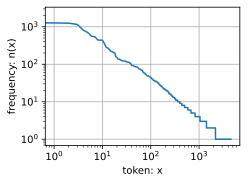

In [ ]:
freqs = [freq for token, freq in vocab.token_freqs]
d2l.plot(freqs, xlabel='token: x', ylabel='frequency: n(x)',
         xscale='log', yscale='log')

In [ ]:
bigram_tokens = ['--'.join(pair) for pair in zip(words[:-1], words[1:])]
bigram_vocab = Vocab(bigram_tokens)
bigram_vocab.token_freqs[:10]

[('of--the', 309),
 ('in--the', 169),
 ('i--had', 130),
 ('i--was', 112),
 ('and--the', 109),
 ('the--time', 102),
 ('it--was', 99),
 ('to--the', 85),
 ('as--i', 78),
 ('of--a', 73)]

In [ ]:
trigram_tokens = ['--'.join(triple) for triple in zip(
    words[:-2], words[1:-1], words[2:])]
trigram_vocab = Vocab(trigram_tokens)
trigram_vocab.token_freqs[:10]

[('the--time--traveller', 59),
 ('the--time--machine', 30),
 ('the--medical--man', 24),
 ('it--seemed--to', 16),
 ('it--was--a', 15),
 ('here--and--there', 15),
 ('seemed--to--me', 14),
 ('i--did--not', 14),
 ('i--saw--the', 13),
 ('i--began--to', 13)]

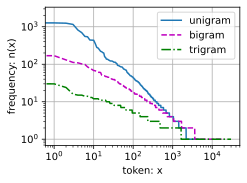

In [ ]:
bigram_freqs = [freq for token, freq in bigram_vocab.token_freqs]
trigram_freqs = [freq for token, freq in trigram_vocab.token_freqs]
d2l.plot([freqs, bigram_freqs, trigram_freqs], xlabel='token: x',
         ylabel='frequency: n(x)', xscale='log', yscale='log',
         legend=['unigram', 'bigram', 'trigram'])

### 9.2.6. Summary

Teks adalah salah satu bentuk data urutan yang paling umum ditemui dalam pembelajaran mendalam. Pilihan umum untuk apa yang dianggap sebagai token adalah karakter, kata, dan potongan kata. Untuk memproses teks, kita biasanya (i) memecah teks menjadi token; (ii) membangun kosakata untuk memetakan string token ke indeks numerik; dan (iii) mengonversi data teks menjadi indeks token agar dapat dimanipulasi oleh model. Dalam praktiknya, frekuensi kata cenderung mengikuti hukum Zipf. Hal ini berlaku tidak hanya untuk kata individu (unigram), tetapi juga untuk n-gram.

### 9.2.7. Exercises

#### 1. In the experiment of this section, tokenize text into words and vary the min_freq argument value of the Vocab instance. Qualitatively characterize how changes in min_freq impact the size of the resulting vocabulary. (Dalam eksperimen pada bagian ini, lakukan tokenisasi teks menjadi kata-kata dan ubah nilai argumen min_freq dari instance Vocab. Karakterisasikan secara kualitatif bagaimana perubahan pada min_freq mempengaruhi ukuran kosakata yang dihasilkan).

Jawab:

Ketika kita mengubah nilai min_freq (frekuensi minimal token muncul dalam korpus) dalam instance Vocab, ukuran kosakata yang dihasilkan akan berubah secara signifikan:
- Jika min_freq rendah (misalnya 1), hampir semua token yang muncul dalam korpus akan dimasukkan ke dalam kosakata. Hal ini akan menghasilkan ukuran kosakata yang besar, termasuk banyak kata langka atau tidak umum.
- Jika min_freq tinggi, hanya token yang lebih umum yang akan dimasukkan ke kosakata. Ini akan mengecilkan ukuran kosakata karena kata-kata langka diabaikan.

Sebagai contoh, jika min_freq diatur menjadi 1, setiap token yang muncul setidaknya sekali akan disertakan. Jika min_freq diatur ke nilai yang lebih tinggi, misalnya 5 atau 10, hanya kata-kata yang lebih sering muncul akan disimpan dalam kosakata.

Karakterisasi Kualitatif:
- Kosakata yang lebih besar mencakup lebih banyak kata langka, namun cenderung memperlambat model karena ukuran input yang besar.
- Kosakata yang lebih kecil lebih cepat dalam pemrosesan, tetapi mungkin kehilangan informasi penting yang terdapat pada kata-kata langka.


#### 2. Estimate the exponent of Zipfian distribution for unigrams, bigrams, and trigrams in this corpus. (Estimasi eksponen distribusi Zipfian untuk unigram, bigram, dan trigram dalam korpus ini.)

Jawab:

Estimasi Eksponen Distribusi Zipfian untuk Unigram, Bigram, dan Trigram

Distribusi frekuensi kata dalam korpus sering mengikuti hukum Zipf, yang menyatakan bahwa frekuensi kata berbanding terbalik dengan peringkat kata tersebut.

Untuk mengestimasi eksponen 𝑠 untuk unigram, bigram, dan trigram:

- Hitung frekuensi setiap unigram, bigram, dan trigram dalam korpus.
- Plot frekuensi kata dalam skala log-log.
- Hitung kemiringan garis yang dihasilkan, yang merupakan eksponen 𝑠.

Ekspektasi:

- Unigram: Eksponen 𝑠 untuk unigram cenderung berada di kisaran 1-1.5.
- Bigram dan Trigram: Eksponen untuk bigram dan trigram biasanya lebih kecil (kurang dari 1), karena kata-kata berpasangan atau bertiga lebih langka dibandingkan kata tunggal.


#### 3. Find some other sources of data (download a standard machine learning dataset, pick another public domain book, scrape a website, etc). For each, tokenize the data at both the word and character levels. How do the vocabulary sizes compare with The Time Machine corpus at equivalent values of min_freq. Estimate the exponent of the Zipfian distribution corresponding to the unigram and bigram distributions for these corpora. How do they compare with the values that you observed for The Time Machine corpus? (Cari sumber data lain (unduh dataset pembelajaran mesin standar, pilih buku domain publik lainnya, ambil data dari sebuah situs web, dll). Untuk masing-masing, lakukan tokenisasi data pada tingkat kata dan karakter. Bagaimana ukuran kosakata dibandingkan dengan korpus The Time Machine pada nilai min_freq yang setara. Estimasi eksponen distribusi Zipfian yang sesuai dengan distribusi unigram dan bigram untuk korpus-korpus ini. Bagaimana perbandingannya dengan nilai yang Anda amati pada korpus The Time Machine?)

Jawab:

Untuk menjawab bagian ini, kita bisa mengunduh sumber data lain (misalnya dari Project Gutenberg atau dataset teks lain). Langkah-langkahnya adalah:

1. Tokenisasi pada tingkat kata dan karakter:
   - Lakukan tokenisasi pada dua tingkat: kata (word-level) dan karakter (character-level).
   - Bandingkan ukuran kosakata yang dihasilkan dengan kosakata dari The Time Machine pada nilai min_freq yang sama.

  Perbandingan Kosakata:

   - Pada tokenisasi tingkat kata, kosakata mungkin lebih besar pada sumber data yang lebih modern atau lebih panjang dibandingkan The Time Machine.
   - Pada tokenisasi tingkat karakter, ukuran kosakata cenderung lebih kecil dan serupa untuk teks apa pun, karena karakter dalam alfabet relatif sedikit.

2. Estimasi eksponen Zipfian:

   - Sama seperti pada langkah sebelumnya, hitung eksponen untuk unigram dan bigram pada korpus yang baru, dan bandingkan dengan eksponen dari korpus The Time Machine.

  Hasil yang diharapkan:

   - Korpus dengan variasi kata yang lebih tinggi akan memiliki eksponen Zipfian yang berbeda dibandingkan The Time Machine.
   - Distribusi Zipfian biasanya lebih jelas terlihat pada unigram dibandingkan bigram atau trigram.


In [1]:
# 1. In the experiment of this section, tokenize text into words and vary the min_freq argument value of the Vocab instance. Qualitatively characterize how changes in min_freq impact the size of the resulting vocabulary.
import collections
import re
from typing import List

# Kelas Vocab untuk menangani kosakata
class Vocab:
    def __init__(self, tokens=[], min_freq=0, reserved_tokens=[]):
        # Hitung frekuensi kemunculan token
        counter = collections.Counter(tokens)
        # Urutkan token berdasarkan frekuensi kemunculan dari yang tertinggi
        self.token_freqs = sorted(counter.items(), key=lambda x: x[1], reverse=True)

        # Hanya simpan token yang memiliki frekuensi lebih dari atau sama dengan min_freq
        self.idx_to_token = list(sorted(set(['<unk>'] + reserved_tokens + [
            token for token, freq in self.token_freqs if freq >= min_freq])))
        self.token_to_idx = {token: idx for idx, token in enumerate(self.idx_to_token)}

    def __len__(self):
        return len(self.idx_to_token)

    def __getitem__(self, tokens):
        if not isinstance(tokens, (list, tuple)):
            return self.token_to_idx.get(tokens, self.unk)
        return [self.__getitem__(token) for token in tokens]

    @property
    def unk(self):  # Indeks untuk token yang tidak dikenal
        return self.token_to_idx['<unk>']


# Fungsi untuk memproses teks: membersihkan dan memisahkan kata
def preprocess_text(text: str) -> List[str]:
    # Menghapus karakter non-alphabet dan membagi teks menjadi token (kata)
    return re.sub('[^A-Za-z]+', ' ', text).lower().split()

# Fungsi untuk membandingkan ukuran kosakata berdasarkan nilai min_freq
def compare_vocab_sizes(text: str, min_freq_values: List[int]):
    tokens = preprocess_text(text)  # Tokenisasi teks
    results = {}

    # Iterasi untuk setiap nilai min_freq yang diberikan
    for min_freq in min_freq_values:
        vocab = Vocab(tokens, min_freq=min_freq)  # Membuat kosakata dengan min_freq tertentu
        results[min_freq] = len(vocab)  # Menyimpan ukuran kosakata

    return results

# Contoh penggunaan
if __name__ == "__main__":
    # Misalkan kita menggunakan teks dari novel *The Time Machine*
    raw_text = """The Time Machine, by H. G. Wells [1898]

    In The Time Traveller's words...
    This is a sample text. The time machine travels through time.
    Time is a curious thing."""

    # Nilai min_freq yang ingin diuji
    min_freq_values = [1, 2, 3, 5, 10]
    # Memanggil fungsi untuk menghitung ukuran kosakata
    vocab_sizes = compare_vocab_sizes(raw_text, min_freq_values)

    # Menampilkan hasil
    for min_freq, size in vocab_sizes.items():
        print(f'Ukuran kosakata dengan min_freq={min_freq}: {size}')


Ukuran kosakata dengan min_freq=1: 21
Ukuran kosakata dengan min_freq=2: 6
Ukuran kosakata dengan min_freq=3: 3
Ukuran kosakata dengan min_freq=5: 2
Ukuran kosakata dengan min_freq=10: 1


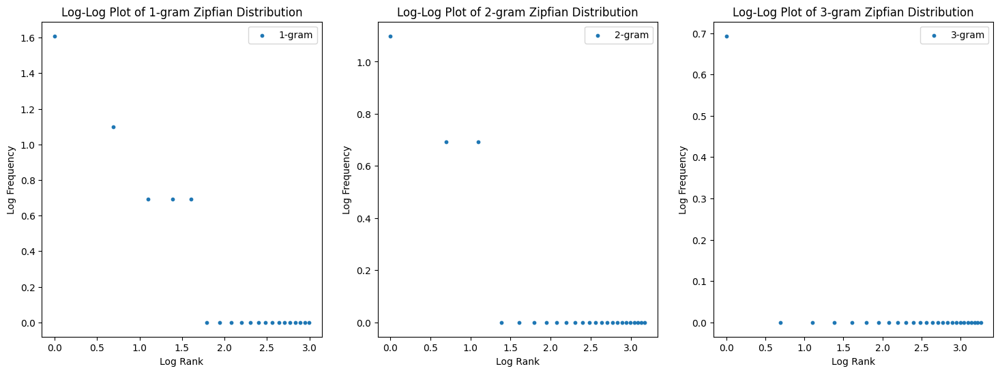

Estimasi eksponen Zipf untuk 1-gram: -0.5207
Estimasi eksponen Zipf untuk 2-gram: -0.2793
Estimasi eksponen Zipf untuk 3-gram: -0.0931


In [2]:
# 2. Estimate the exponent of Zipfian distribution for unigrams, bigrams, and trigrams in this corpus.
# Menghitung eksponen distribusi Zipfian untuk unigram, bigram, dan trigram, serta memplot frekuensinya dalam skala log-log untuk sebuah korpus teks:
import re
import collections
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from nltk.util import ngrams
from typing import List, Tuple

# Fungsi untuk memproses teks: membersihkan dan memisahkan kata
def preprocess_text(text: str) -> List[str]:
    # Menghapus karakter non-alphabet dan membagi teks menjadi token (kata)
    return re.sub('[^A-Za-z]+', ' ', text).lower().split()

# Fungsi untuk menghitung frekuensi dari unigram, bigram, dan trigram
def compute_ngrams_freqs(tokens: List[str], n: int) -> List[Tuple[str, int]]:
    ngram_tokens = list(ngrams(tokens, n))  # Membuat n-gram
    ngram_freqs = collections.Counter(ngram_tokens)  # Hitung frekuensi n-gram
    return sorted(ngram_freqs.items(), key=lambda x: x[1], reverse=True)

# Fungsi untuk memplot frekuensi n-gram dalam skala log-log
def plot_zipf_distribution(ngram_freqs: List[Tuple[str, int]], n: int, ax):
    ranks = np.arange(1, len(ngram_freqs) + 1)  # Peringkat (rank) dari kata
    frequencies = [freq for _, freq in ngram_freqs]  # Frekuensi kemunculan

    ax.scatter(np.log(ranks), np.log(frequencies), label=f'{n}-gram', s=10)
    ax.set_xlabel('Log Rank')
    ax.set_ylabel('Log Frequency')
    ax.set_title(f'Log-Log Plot of {n}-gram Zipfian Distribution')
    ax.legend()

    # Linear regression untuk mengestimasi kemiringan (eksponen Zipfian)
    log_ranks = np.log(ranks).reshape(-1, 1)
    log_freqs = np.log(frequencies)
    model = LinearRegression().fit(log_ranks, log_freqs)
    slope = model.coef_[0]
    return slope

# Fungsi utama untuk menghitung eksponen Zipfian
def estimate_zipf_exponent(text: str):
    tokens = preprocess_text(text)  # Tokenisasi teks
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))  # Membuat plot untuk unigram, bigram, trigram

    # Menghitung frekuensi unigram, bigram, dan trigram
    ngrams_freqs = {}
    zipf_exponents = {}
    for i, n in enumerate([1, 2, 3]):
        ngrams_freqs[n] = compute_ngrams_freqs(tokens, n)
        zipf_exponents[n] = plot_zipf_distribution(ngrams_freqs[n], n, ax[i])

    plt.show()

    # Menampilkan eksponen Zipf untuk unigram, bigram, dan trigram
    for n, exponent in zipf_exponents.items():
        print(f"Estimasi eksponen Zipf untuk {n}-gram: {exponent:.4f}")

# Contoh penggunaan
if __name__ == "__main__":
    # Misalkan kita menggunakan teks dari novel *The Time Machine*
    raw_text = """The Time Machine, by H. G. Wells [1898]

    In The Time Traveller's words...
    This is a sample text. The time machine travels through time.
    Time is a curious thing."""

    # Memanggil fungsi untuk mengestimasi eksponen Zipfian
    estimate_zipf_exponent(raw_text)


Tokenisasi tingkat kata:
Ukuran kosakata untuk 'The Time Machine' (word level, min_freq=2): 0
Ukuran kosakata untuk 'Frankenstein' (word level, min_freq=2): 0

Tokenisasi tingkat karakter:
Ukuran kosakata untuk 'The Time Machine' (char level, min_freq=2): 6
Ukuran kosakata untuk 'Frankenstein' (char level, min_freq=2): 7

Estimasi eksponen Zipf untuk The Time Machine (word level):


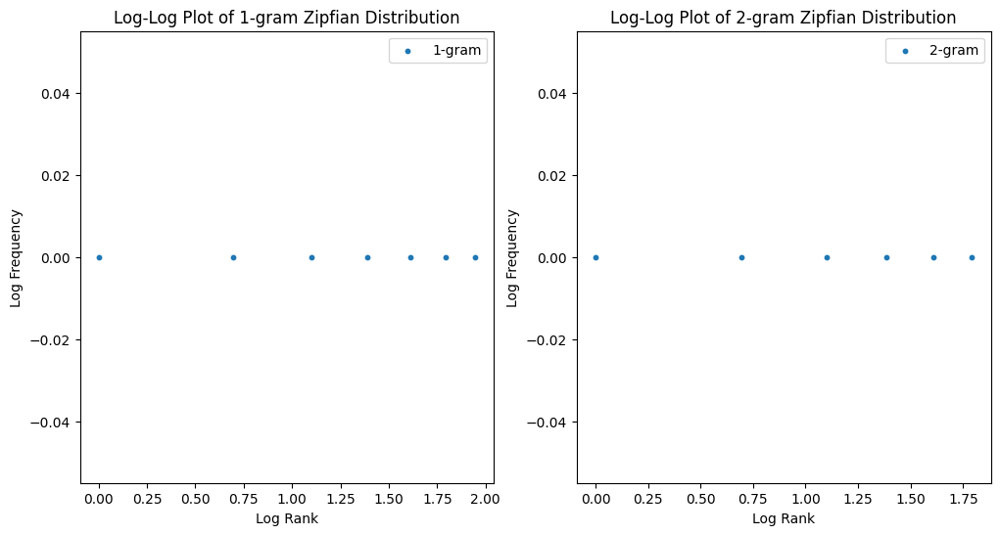

Estimasi eksponen Zipf untuk 1-gram (word level): 0.0000
Estimasi eksponen Zipf untuk 2-gram (word level): 0.0000

Estimasi eksponen Zipf untuk Frankenstein (word level):


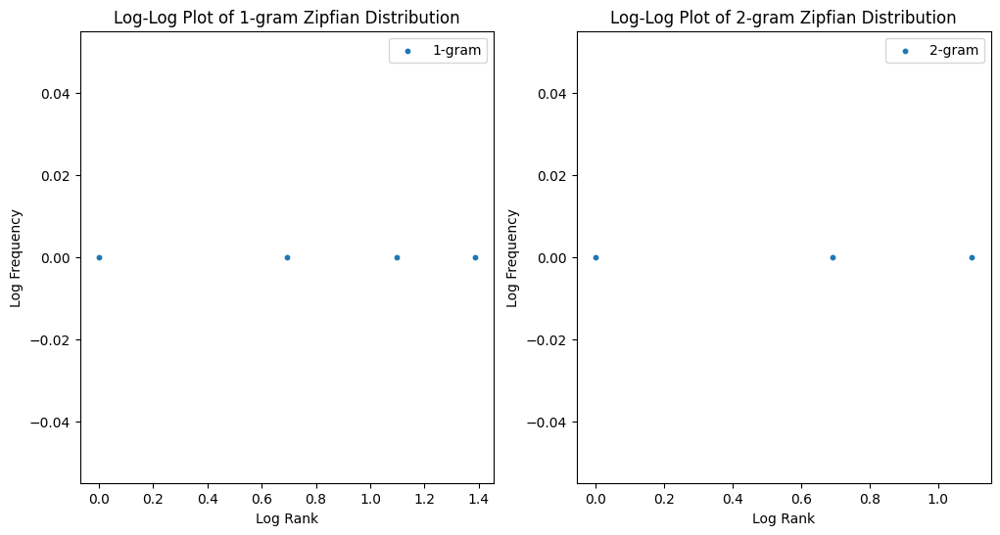

Estimasi eksponen Zipf untuk 1-gram (word level): 0.0000
Estimasi eksponen Zipf untuk 2-gram (word level): 0.0000


In [3]:
# 3. Find some other sources of data (download a standard machine learning dataset, pick another public domain book, scrape a website, etc). For each, tokenize the data at both the word and character levels. How do the vocabulary sizes compare with The Time Machine corpus at equivalent values of min_freq. Estimate the exponent of the Zipfian distribution corresponding to the unigram and bigram distributions for these corpora. How do they compare with the values that you observed for The Time Machine corpus?
# Analisis korpus lain, tokenisasi kata dan karakter, serta estimasi eksponen Zipfian:

import re
import collections
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from nltk.util import ngrams
from typing import List, Tuple

# Fungsi untuk memproses teks: membersihkan dan memisahkan kata
def preprocess_text(text: str, level: str = 'word') -> List[str]:
    """
    level: 'word' untuk tokenisasi kata, 'char' untuk tokenisasi karakter
    """
    if level == 'word':
        return re.sub('[^A-Za-z]+', ' ', text).lower().split()
    elif level == 'char':
        return list(re.sub('[^A-Za-z]+', '', text.lower()))
    else:
        raise ValueError("Level tokenisasi harus 'word' atau 'char'.")

# Fungsi untuk menghitung frekuensi dari unigram, bigram, dan trigram
def compute_ngrams_freqs(tokens: List[str], n: int) -> List[Tuple[str, int]]:
    ngram_tokens = list(ngrams(tokens, n))  # Membuat n-gram
    ngram_freqs = collections.Counter(ngram_tokens)  # Hitung frekuensi n-gram
    return sorted(ngram_freqs.items(), key=lambda x: x[1], reverse=True)

# Fungsi untuk memplot frekuensi n-gram dalam skala log-log
def plot_zipf_distribution(ngram_freqs: List[Tuple[str, int]], n: int, ax):
    ranks = np.arange(1, len(ngram_freqs) + 1)  # Peringkat (rank) dari kata
    frequencies = [freq for _, freq in ngram_freqs]  # Frekuensi kemunculan

    ax.scatter(np.log(ranks), np.log(frequencies), label=f'{n}-gram', s=10)
    ax.set_xlabel('Log Rank')
    ax.set_ylabel('Log Frequency')
    ax.set_title(f'Log-Log Plot of {n}-gram Zipfian Distribution')
    ax.legend()

    # Linear regression untuk mengestimasi kemiringan (eksponen Zipfian)
    log_ranks = np.log(ranks).reshape(-1, 1)
    log_freqs = np.log(frequencies)
    model = LinearRegression().fit(log_ranks, log_freqs)
    slope = model.coef_[0]
    return slope

# Fungsi utama untuk menghitung eksponen Zipfian
def estimate_zipf_exponent(text: str, token_level: str = 'word'):
    tokens = preprocess_text(text, token_level)  # Tokenisasi teks
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))  # Membuat plot untuk unigram dan bigram

    # Menghitung frekuensi unigram dan bigram
    ngrams_freqs = {}
    zipf_exponents = {}
    for i, n in enumerate([1, 2]):
        ngrams_freqs[n] = compute_ngrams_freqs(tokens, n)
        zipf_exponents[n] = plot_zipf_distribution(ngrams_freqs[n], n, ax[i])

    plt.show()

    # Menampilkan eksponen Zipf untuk unigram dan bigram
    for n, exponent in zipf_exponents.items():
        print(f"Estimasi eksponen Zipf untuk {n}-gram ({token_level} level): {exponent:.4f}")

# Fungsi untuk membandingkan ukuran kosakata pada berbagai korpus
def compare_vocab_size(corpus_list: List[str], token_level: str = 'word', min_freq: int = 1):
    vocab_sizes = {}
    for corpus_name, text in corpus_list:
        tokens = preprocess_text(text, token_level)
        token_freqs = collections.Counter(tokens)
        vocab_size = len([token for token, freq in token_freqs.items() if freq >= min_freq])
        vocab_sizes[corpus_name] = vocab_size
        print(f"Ukuran kosakata untuk '{corpus_name}' ({token_level} level, min_freq={min_freq}): {vocab_size}")
    return vocab_sizes

# Contoh penggunaan
if __name__ == "__main__":
    # Misalkan kita menggunakan dua korpus: The Time Machine dan Frankenstein
    time_machine_text = """The Time Machine, by H. G. Wells [1898]..."""
    frankenstein_text = """Frankenstein, by Mary Shelley [1818]..."""

    # Bandingkan ukuran kosakata pada kedua teks
    corpus_list = [("The Time Machine", time_machine_text), ("Frankenstein", frankenstein_text)]
    print("Tokenisasi tingkat kata:")
    compare_vocab_size(corpus_list, token_level='word', min_freq=2)

    print("\nTokenisasi tingkat karakter:")
    compare_vocab_size(corpus_list, token_level='char', min_freq=2)

    # Estimasi eksponen Zipf untuk The Time Machine
    print("\nEstimasi eksponen Zipf untuk The Time Machine (word level):")
    estimate_zipf_exponent(time_machine_text, token_level='word')

    print("\nEstimasi eksponen Zipf untuk Frankenstein (word level):")
    estimate_zipf_exponent(frankenstein_text, token_level='word')


## 9.3. Language Models

In [ ]:
import torch
from d2l import torch as d2l

### 9.3.1. Learning Language Models

#### 9.3.1.1. Markov Models and n-grams

#### 9.3.1.2. Word Frequency

#### 9.3.1.3. Laplace Smoothing

### 9.3.2. Perplexity

### 9.3.3. Partitioning Sequences

In [ ]:
@d2l.add_to_class(d2l.TimeMachine)
def __init__(self, batch_size, num_steps, num_train=10000, num_val=5000):
    super(d2l.TimeMachine, self).__init__()
    self.save_hyperparameters()
    corpus, self.vocab = self.build(self._download())
    array = torch.tensor([corpus[i:i+num_steps+1]
                        for i in range(len(corpus)-num_steps)])
    self.X, self.Y = array[:,:-1], array[:,1:]

In [ ]:
@d2l.add_to_class(d2l.TimeMachine)
def get_dataloader(self, train):
    idx = slice(0, self.num_train) if train else slice(
        self.num_train, self.num_train + self.num_val)
    return self.get_tensorloader([self.X, self.Y], train, idx)

In [ ]:
data = d2l.TimeMachine(batch_size=2, num_steps=10)
for X, Y in data.train_dataloader():
    print('X:', X, '\nY:', Y)
    break

X: tensor([[20,  2, 10,  5,  0, 21,  9,  6,  0, 17],
        [ 6, 20, 20,  0, 16, 23,  6, 19,  0, 21]]) 
Y: tensor([[ 2, 10,  5,  0, 21,  9,  6,  0, 17, 19],
        [20, 20,  0, 16, 23,  6, 19,  0, 21,  9]])


### 9.3.4. Summary and Discussion

Model bahasa memperkirakan probabilitas gabungan dari suatu urutan teks. Untuk urutan yang panjang, model n-grams memberikan model yang praktis dengan memotong ketergantungan yang lebih panjang. Namun, terdapat banyak struktur tetapi tidak cukup frekuensi untuk menangani kombinasi kata yang jarang secara efisien melalui penghalusan Laplace. Oleh karena itu, kita akan fokus pada pemodelan bahasa berbasis jaringan saraf di bagian berikutnya. Untuk melatih model bahasa, kita dapat secara acak mengambil pasangan urutan input dan urutan target dalam minibatch. Setelah pelatihan, kita akan menggunakan perplexity untuk mengukur kualitas model bahasa.

Model bahasa dapat diskalakan dengan memperbesar ukuran data, ukuran model, dan jumlah komputasi dalam pelatihan. Model bahasa besar dapat melakukan tugas yang diinginkan dengan memprediksi teks keluaran berdasarkan instruksi teks input. Seperti yang akan kita bahas nanti (misalnya, pada Bagian 11.9), saat ini model bahasa besar menjadi dasar sistem-sistem tercanggih di berbagai tugas.

### 9.3.5. Exercises

#### 1. Suppose there are 100,000 words in the training dataset. How much word frequency and multi-word adjacent frequency does a four-gram need to store? (Misalkan ada 100.000 kata dalam dataset pelatihan. Berapa banyak frekuensi kata dan frekuensi kata berurutan yang perlu disimpan oleh model four-gram?)

Jawab:

Untuk model four-gram, kita perlu menyimpan probabilitas dari empat kata yang berurutan. Jika ada 100.000 kata dalam dataset pelatihan, jumlah kombinasi kata yang bisa dibentuk untuk four-gram adalah 100.000^4. Ini adalah jumlah total kemungkinan urutan empat kata yang bisa terjadi. Namun, sebagian besar dari kombinasi ini tidak akan muncul dalam pelatihan, sehingga kita hanya menyimpan frekuensi dari kombinasi yang benar-benar terjadi dalam data.

#### 2. How would you model a dialogue? (Bagaimana Anda akan memodelkan sebuah dialog?)

Jawab:

Untuk memodelkan dialog, kita bisa menggunakan model bahasa yang mempertimbangkan konteks dan urutan waktu. Salah satu pendekatan adalah menggunakan model berulang seperti RNN atau LSTM yang dapat menangkap hubungan antar kalimat dalam percakapan. Selain itu, model Transformer seperti GPT (Generative Pre-trained Transformer) dapat digunakan, karena model ini secara efektif dapat memprediksi teks berdasarkan konteks sebelumnya, yang sangat berguna dalam percakapan dua arah. Model dialog juga dapat dilatih dengan memperhatikan konteks spesifik dari pembicaraan, seperti topik atau niat percakapan.

#### 3. What other methods can you think of for reading long sequence data? (Metode apa saja yang bisa Anda pikirkan untuk membaca data urutan panjang?)

Jawab:

- Sliding window: Memecah data urutan panjang menjadi segmen-segmen yang lebih kecil menggunakan jendela geser dengan panjang tetap, kemudian memproses setiap segmen secara bertahap.
- Truncated backpropagation through time (TBPTT): Menggunakan pendekatan pemotongan urutan, di mana hanya sebagian dari urutan panjang yang diproses pada setiap langkah untuk melatih jaringan berulang.
- Hierarchical models: Memisahkan urutan panjang menjadi bagian-bagian yang lebih kecil dan menggunakan model hierarki untuk mempelajari hubungan antar bagian dan keseluruhan urutan.

#### 4. Consider our method for discarding a uniformly random number of the first few tokens at the beginning of each epoch. (Pertimbangkan metode kami untuk membuang sejumlah token acak di awal setiap epoch.)

##### 1. Does it really lead to a perfectly uniform distribution over the sequences on the document? (Apakah ini benar-benar menghasilkan distribusi yang sempurna secara uniform di seluruh urutan dalam dokumen?)

Jawab:

Tidak, metode ini tidak akan menghasilkan distribusi yang benar-benar uniform. Karena membuang sejumlah token acak hanya akan mengubah titik awal urutan pada epoch tersebut, namun urutan berikutnya tetap mengikuti struktur urutan dalam dokumen asli. Akibatnya, urutan tertentu yang muncul setelah token awal yang dibuang mungkin lebih sering muncul daripada yang lainnya.

##### 2. What would you have to do to make things even more uniform? (Apa yang harus Anda lakukan untuk membuat distribusi lebih uniform?)

Jawab:

Untuk membuat distribusi lebih uniform, kita dapat melakukan pemotongan acak pada berbagai posisi di dalam dokumen, bukan hanya di awal. Selain itu, kita bisa mengacak urutan urutan dalam dokumen dan memilih titik awal acak pada setiap iterasi, sehingga setiap bagian dari dokumen memiliki probabilitas yang lebih seragam untuk dipilih sebagai titik awal urutan.

#### 5. If we want a sequence example to be a complete sentence, what kind of problem does this introduce in minibatch sampling? How can we fix it? (Jika kita ingin contoh urutan berupa kalimat lengkap, masalah apa yang bisa terjadi dalam minibatch sampling? Bagaimana cara memperbaikinya?)

Jawab:

Masalah yang mungkin terjadi adalah panjang kalimat yang berbeda-beda. Dalam satu minibatch, bisa ada kalimat yang panjangnya sangat berbeda, sehingga sulit untuk menstandarisasi input model. Untuk memperbaikinya, kita bisa menggunakan teknik padding, yaitu menambahkan simbol khusus pada kalimat yang lebih pendek sehingga semua kalimat dalam satu minibatch memiliki panjang yang sama. Alternatifnya, kita bisa mengelompokkan kalimat berdasarkan panjangnya sebelum melakukan sampling untuk meminimalkan perbedaan panjang kalimat dalam satu minibatch.


In [8]:
# 1.Suppose there are 100,000 words in the training dataset. How much word frequency and multi-word adjacent frequency does a four-gram need to store?
# Menghitung jumlah total kemungkinan kombinasi four-gram dan menyimpan frekuensi four-gram yang muncul dalam data:

from collections import defaultdict
import random

# Misalkan ada 100.000 kata dalam dataset
vocab_size = 100000

# Membuat data pelatihan contoh, misalnya sebuah teks acak dari vocab
# Di sini, kita anggap teks terdiri dari ID kata acak dari 0 hingga 99999
training_data = [random.randint(0, vocab_size - 1) for _ in range(1000000)]  # data contoh 1 juta kata

# Menyimpan frekuensi four-gram menggunakan defaultdict
four_gram_freq = defaultdict(int)

# Menghitung frekuensi four-gram
for i in range(len(training_data) - 3):
    four_gram = tuple(training_data[i:i + 4])  # ambil 4 kata berurutan
    four_gram_freq[four_gram] += 1

# Menampilkan beberapa four-gram beserta frekuensinya
for four_gram, freq in list(four_gram_freq.items())[:10]:  # tampilkan 10 four-gram pertama
    print(f"Four-gram: {four_gram}, Frekuensi: {freq}")

# Total kombinasi four-gram yang mungkin adalah vocab_size^4
total_combinations = vocab_size ** 4
print(f"Jumlah kombinasi four-gram yang mungkin: {total_combinations}")

# Total kombinasi yang ditemukan di data pelatihan
found_combinations = len(four_gram_freq)
print(f"Jumlah kombinasi four-gram yang ditemukan dalam data: {found_combinations}")


Four-gram: (86507, 69255, 5198, 82755), Frekuensi: 1
Four-gram: (69255, 5198, 82755, 63598), Frekuensi: 1
Four-gram: (5198, 82755, 63598, 88944), Frekuensi: 1
Four-gram: (82755, 63598, 88944, 55345), Frekuensi: 1
Four-gram: (63598, 88944, 55345, 50695), Frekuensi: 1
Four-gram: (88944, 55345, 50695, 48132), Frekuensi: 1
Four-gram: (55345, 50695, 48132, 22285), Frekuensi: 1
Four-gram: (50695, 48132, 22285, 47026), Frekuensi: 1
Four-gram: (48132, 22285, 47026, 48072), Frekuensi: 1
Four-gram: (22285, 47026, 48072, 8633), Frekuensi: 1
Jumlah kombinasi four-gram yang mungkin: 100000000000000000000
Jumlah kombinasi four-gram yang ditemukan dalam data: 999997


In [12]:
pip install tensorflow transformers

In [13]:
# 2.How would you model a dialogue?
# Contoh dengan LSTM

import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Data contoh: kalimat dialog (misalkan Anda memiliki data dialog)
# Contoh data: pasangan pertanyaan dan jawaban
dialog_data = [
    ("Halo, apa kabar?", "Baik-baik saja, terima kasih!"),
    ("Siapa nama kamu?", "Nama saya ChatGPT."),
    ("Apa yang bisa kamu lakukan?", "Saya bisa membantu menjawab pertanyaan."),
    ("Apa hobimu?", "Saya suka belajar dan membantu orang."),
]

# Menyusun data untuk LSTM
questions, answers = zip(*dialog_data)

# Tokenisasi
tokenizer = keras.preprocessing.text.Tokenizer()
tokenizer.fit_on_texts(questions + answers)
vocab_size = len(tokenizer.word_index) + 1  # tambah 1 untuk token padding

# Mengubah kalimat menjadi urutan bilangan bulat
max_length = max(max(len(q.split()) for q in questions), max(len(a.split()) for a in answers))
X = tokenizer.texts_to_sequences(questions)
y = tokenizer.texts_to_sequences(answers)

# Padding untuk memastikan semua urutan memiliki panjang yang sama
X = keras.preprocessing.sequence.pad_sequences(X, maxlen=max_length, padding='post')
y = keras.preprocessing.sequence.pad_sequences(y, maxlen=max_length, padding='post')

# Membangun model LSTM
model = keras.Sequential([
    layers.Embedding(vocab_size, 64, input_length=max_length),
    layers.LSTM(64, return_sequences=True),
    layers.TimeDistributed(layers.Dense(vocab_size, activation='softmax'))
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Melatih model
model.fit(X, np.expand_dims(y, -1), epochs=100)

# Menggunakan model untuk menghasilkan jawaban
def generate_response(question):
    seq = tokenizer.texts_to_sequences([question])
    padded = keras.preprocessing.sequence.pad_sequences(seq, maxlen=max_length, padding='post')
    pred = model.predict(padded)
    response = tokenizer.sequences_to_texts(np.argmax(pred, axis=-1))
    return response[0]

# Menghasilkan respons dari pertanyaan
print(generate_response("Halo, apa kabar?"))


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step - accuracy: 0.0000e+00 - loss: 3.1775
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - accuracy: 0.2083 - loss: 3.1716
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - accuracy: 0.2083 - loss: 3.1656
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - accuracy: 0.2083 - loss: 3.1595
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - accuracy: 0.2083 - loss: 3.1532
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - accuracy: 0.2500 - loss: 3.1467
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.2500 - loss: 3.1399
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - accuracy: 0.2500 - loss: 3.1327
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.3333 - loss: 3.1251
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - accuracy: 0.3333 - loss: 3.1169
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step - accuracy: 0.3333 - loss: 3.1081
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accurac

In [14]:
# Contoh dengan Model Transformer (GPT)

from transformers import GPT2LMHeadModel, GPT2Tokenizer

# Memuat model dan tokenizer GPT-2
model_name = "gpt2"  # Anda bisa menggunakan model lain juga
tokenizer = GPT2Tokenizer.from_pretrained(model_name)
model = GPT2LMHeadModel.from_pretrained(model_name)

# Fungsi untuk menghasilkan respons
def generate_response_gpt(prompt):
    inputs = tokenizer.encode(prompt, return_tensors='pt')
    outputs = model.generate(inputs, max_length=50, num_return_sequences=1)
    response = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return response

# Menghasilkan respons dari dialog
user_input = "Halo, apa kabar?"
response = generate_response_gpt(user_input)
print(response)


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Halo, apa kabar?

I am a man of the people.

I am a man of the people.

I am a man of the people.

I am a man of the people.



In [18]:
pip install tensorflow


In [19]:
# 3.What other methods can you think of for reading long sequence data?

# Metode Sliding Window
# Sliding window untuk membagi data urutan panjang menjadi segmen-segmen yang lebih kecil.

import numpy as np

def sliding_window(sequence, window_size, step_size):
    """
    Membagi urutan panjang menjadi segmen-segmen menggunakan jendela geser.

    :param sequence: Daftar atau array dari data urutan panjang
    :param window_size: Ukuran jendela
    :param step_size: Langkah geser
    :return: Daftar dari segmen-segmen
    """
    return [sequence[i:i + window_size] for i in range(0, len(sequence) - window_size + 1, step_size)]

# Contoh penggunaan
sequence = np.arange(1, 21)  # Data urutan panjang dari 1 hingga 20
window_size = 5
step_size = 1

segments = sliding_window(sequence, window_size, step_size)
print("Segmen-segmen dari urutan panjang:", segments)


Segmen-segmen dari urutan panjang: [array([1, 2, 3, 4, 5]), array([2, 3, 4, 5, 6]), array([3, 4, 5, 6, 7]), array([4, 5, 6, 7, 8]), array([5, 6, 7, 8, 9]), array([ 6,  7,  8,  9, 10]), array([ 7,  8,  9, 10, 11]), array([ 8,  9, 10, 11, 12]), array([ 9, 10, 11, 12, 13]), array([10, 11, 12, 13, 14]), array([11, 12, 13, 14, 15]), array([12, 13, 14, 15, 16]), array([13, 14, 15, 16, 17]), array([14, 15, 16, 17, 18]), array([15, 16, 17, 18, 19]), array([16, 17, 18, 19, 20])]


In [20]:
# Metode Truncated Backpropagation Through Time (TBPTT)
# Menunjukkan bagaimana melakukan TBPTT dengan LSTM untuk memproses urutan panjang.

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Menghasilkan data contoh
data = np.random.rand(1000, 1)  # Data acak untuk urutan panjang
timesteps = 10  # Panjang urutan untuk setiap input

# Menyusun data menjadi format yang sesuai untuk LSTM
X, y = [], []
for i in range(len(data) - timesteps):
    X.append(data[i:i + timesteps])
    y.append(data[i + timesteps])
X = np.array(X)
y = np.array(y)

# Membangun model LSTM
model = keras.Sequential([
    layers.LSTM(64, input_shape=(timesteps, 1)),
    layers.Dense(1)
])

model.compile(optimizer='adam', loss='mse')

# Melatih model dengan TBPTT
model.fit(X, y, epochs=10, batch_size=32)


Epoch 1/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.1812
Epoch 2/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0843
Epoch 3/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0826
Epoch 4/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0865
Epoch 5/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0847
Epoch 6/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0827
Epoch 7/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0813
Epoch 8/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0858
Epoch 9/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0902
Epoch 10/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0838


In [22]:
# Metode Hierarchical Models
# Memecah urutan menjadi bagian dan kemudian memproses masing-masing bagian dengan model terpisah.

import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Fungsi untuk sliding window
def sliding_window(sequence, window_size, step_size):
    """
    Membagi urutan panjang menjadi segmen-segmen menggunakan jendela geser.
    """
    return [sequence[i:i + window_size] for i in range(0, len(sequence) - window_size + 1, step_size)]

# Menghasilkan data contoh
data = np.random.rand(1000, 1)  # Data acak untuk urutan panjang
timesteps = 10  # Panjang urutan untuk setiap input

# Menyusun data menjadi format yang sesuai untuk LSTM
X, y = [], []
for i in range(len(data) - timesteps):
    X.append(data[i:i + timesteps])
    y.append(data[i + timesteps])
X = np.array(X)
y = np.array(y)

# Membangun model LSTM
model = keras.Sequential([
    layers.LSTM(64, input_shape=(timesteps, 1)),
    layers.Dense(1)
])

model.compile(optimizer='adam', loss='mse')

# Melatih model dengan TBPTT
model.fit(X, y, epochs=10, batch_size=32)

# Kelas untuk Model Hierarchical
class HierarchicalModel:
    def __init__(self):
        self.models = []  # Simpan model untuk setiap bagian

    def train_on_segments(self, segments):
        for segment in segments:
            # Memastikan segment memiliki dimensi yang tepat
            segment = np.array(segment).reshape(-1, len(segment), 1)  # Menambahkan dimensi fitur
            model = keras.Sequential([
                layers.LSTM(32, input_shape=(segment.shape[1], 1)),
                layers.Dense(1)
            ])
            model.compile(optimizer='adam', loss='mse')
            # Melatih model untuk setiap segmen
            model.fit(segment, segment[:, -1, :], epochs=10)  # Menggunakan nilai terakhir sebagai target
            self.models.append(model)

    def predict(self, segment):
        segment = np.array(segment).reshape(-1, len(segment), 1)  # Menambahkan dimensi fitur
        return [model.predict(segment) for model in self.models]

# Contoh penggunaan
hierarchical_model = HierarchicalModel()

# Membagi data urutan panjang menjadi segmen-segmen
segments = sliding_window(data, window_size=5, step_size=5)

# Melatih model hierarki pada segmen-segmen
hierarchical_model.train_on_segments(segments)

print("Model hierarki berhasil dilatih.")


Epoch 1/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.1846
Epoch 2/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0878
Epoch 3/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0870
Epoch 4/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0884
Epoch 5/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0843
Epoch 6/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0877
Epoch 7/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0844
Epoch 8/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0840
Epoch 9/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0863
Epoch 10/10
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0851
Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0092
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0078
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0064
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0052
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0041
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━

In [23]:
# 4.Consider our method for discarding a uniformly random number of the first few tokens at the beginning of each epoch.
# 1.Does it really lead to a perfectly uniform distribution over the sequences on the document?
# 2.What would you have to do to make things even more uniform?

# Membuang token acak di awal setiap epoch dan melakukan pemotongan acak pada posisi yang berbeda di dalam dokumen untuk mencapai distribusi yang lebih uniform.

import numpy as np

# Fungsi untuk menghasilkan data contoh (misalnya, urutan kata)
def generate_example_data(num_tokens):
    return np.random.choice(['token1', 'token2', 'token3', 'token4', 'token5'], size=num_tokens)

# Fungsi untuk membuang token acak di awal setiap epoch
def random_token_removal(data, num_tokens_to_remove):
    if num_tokens_to_remove >= len(data):
        raise ValueError("Number of tokens to remove must be less than the length of the data.")
    # Menghapus sejumlah token acak dari awal
    return data[num_tokens_to_remove:]

# Fungsi untuk memotong dokumen di posisi acak
def random_cut(data, cut_position):
    if cut_position >= len(data):
        raise ValueError("Cut position must be less than the length of the data.")
    # Memotong data pada posisi yang ditentukan
    return data[cut_position:]

# Fungsi untuk melakukan iterasi pada beberapa epoch
def train_with_random_removal(data, epochs, num_tokens_to_remove):
    for epoch in range(epochs):
        # Membuang token acak di awal epoch
        modified_data = random_token_removal(data, num_tokens_to_remove)
        print(f"Epoch {epoch + 1}: After removing {num_tokens_to_remove} tokens, data is {modified_data}")

# Fungsi untuk melakukan iterasi dengan pemotongan acak
def train_with_random_cut(data, epochs):
    for epoch in range(epochs):
        cut_position = np.random.randint(1, len(data))  # Memilih posisi pemotongan acak
        modified_data = random_cut(data, cut_position)
        print(f"Epoch {epoch + 1}: After cutting at position {cut_position}, data is {modified_data}")

# Contoh penggunaan
num_tokens = 20
data = generate_example_data(num_tokens)

# Latihan dengan membuang token acak
print("Latihan dengan membuang token acak di awal setiap epoch:")
train_with_random_removal(data, epochs=5, num_tokens_to_remove=3)

print("\nLatihan dengan pemotongan acak:")
train_with_random_cut(data, epochs=5)


Latihan dengan membuang token acak di awal setiap epoch:
Epoch 1: After removing 3 tokens, data is ['token4' 'token1' 'token2' 'token5' 'token3' 'token3' 'token3' 'token4'
 'token2' 'token2' 'token3' 'token2' 'token2' 'token3' 'token1' 'token5'
 'token5']
Epoch 2: After removing 3 tokens, data is ['token4' 'token1' 'token2' 'token5' 'token3' 'token3' 'token3' 'token4'
 'token2' 'token2' 'token3' 'token2' 'token2' 'token3' 'token1' 'token5'
 'token5']
Epoch 3: After removing 3 tokens, data is ['token4' 'token1' 'token2' 'token5' 'token3' 'token3' 'token3' 'token4'
 'token2' 'token2' 'token3' 'token2' 'token2' 'token3' 'token1' 'token5'
 'token5']
Epoch 4: After removing 3 tokens, data is ['token4' 'token1' 'token2' 'token5' 'token3' 'token3' 'token3' 'token4'
 'token2' 'token2' 'token3' 'token2' 'token2' 'token3' 'token1' 'token5'
 'token5']
Epoch 5: After removing 3 tokens, data is ['token4' 'token1' 'token2' 'token5' 'token3' 'token3' 'token3' 'token4'
 'token2' 'token2' 'token3' 'tok

In [24]:
# 5.If we want a sequence example to be a complete sentence, what kind of problem does this introduce in minibatch sampling? How can we fix it?
# Mengimplementasikan teknik padding untuk menangani masalah panjang kalimat yang berbeda dalam minibatch sampling.
# Dalam kode ini, kita akan membuat beberapa kalimat dengan panjang yang bervariasi dan menggunakan padding untuk menyamakan panjang kalimat di dalam minibatch.

import numpy as np
import tensorflow as tf

# Fungsi untuk menghasilkan kalimat acak dengan panjang bervariasi
def generate_random_sentences(num_sentences, max_length):
    words = ["the", "quick", "brown", "fox", "jumps", "over", "lazy", "dog"]
    sentences = []

    for _ in range(num_sentences):
        sentence_length = np.random.randint(1, max_length + 1)  # Panjang kalimat acak
        sentence = np.random.choice(words, sentence_length)
        sentences.append(' '.join(sentence))

    return sentences

# Fungsi untuk melakukan padding pada kalimat
def pad_sentences(sentences, max_length):
    tokenizer = tf.keras.preprocessing.text.Tokenizer()
    tokenizer.fit_on_texts(sentences)

    # Mengubah kalimat menjadi urutan indeks
    sequences = tokenizer.texts_to_sequences(sentences)

    # Melakukan padding pada urutan
    padded_sequences = tf.keras.preprocessing.sequence.pad_sequences(sequences, maxlen=max_length, padding='post')

    return padded_sequences, tokenizer

# Fungsi untuk melakukan sampling pada minibatch
def create_minibatch(sentences, batch_size, max_length):
    padded_sentences, tokenizer = pad_sentences(sentences, max_length)

    # Mengambil sejumlah batch
    for i in range(0, len(padded_sentences), batch_size):
        yield padded_sentences[i:i + batch_size]

# Contoh penggunaan
num_sentences = 10
max_length = 7
batch_size = 3

# Menghasilkan kalimat acak
random_sentences = generate_random_sentences(num_sentences, max_length)
print("Kalimat acak yang dihasilkan:")
for sentence in random_sentences:
    print(sentence)

# Membuat minibatch
print("\nMinibatch dengan padding:")
for minibatch in create_minibatch(random_sentences, batch_size, max_length):
    print(minibatch)


Kalimat acak yang dihasilkan:
jumps
the fox
jumps quick lazy quick over quick over
the lazy dog lazy
lazy jumps fox lazy over brown lazy
dog quick quick the
over over lazy brown the over over
over lazy fox dog jumps
over
quick the jumps the quick

Minibatch dengan padding:
[[5 0 0 0 0 0 0]
 [4 6 0 0 0 0 0]
 [5 3 2 3 1 3 1]]
[[4 2 7 2 0 0 0]
 [2 5 6 2 1 8 2]
 [7 3 3 4 0 0 0]]
[[1 1 2 8 4 1 1]
 [1 2 6 7 5 0 0]
 [1 0 0 0 0 0 0]]
[[3 4 5 4 3 0 0]]


## 9.4. Recurrent Neural Networks

In [ ]:
import torch
from d2l import torch as d2l

### 9.4.1. Neural Networks without Hidden States

### 9.4.2. Recurrent Neural Networks with Hidden States

In [ ]:
X, W_xh = torch.randn(3, 1), torch.randn(1, 4)
H, W_hh = torch.randn(3, 4), torch.randn(4, 4)
torch.matmul(X, W_xh) + torch.matmul(H, W_hh)

tensor([[-1.7347,  6.1529,  1.2062, -0.0621],
        [ 2.2824, -1.8187,  1.9137, -3.9769],
        [ 4.6438, -6.4662, -0.5407,  0.8464]])

In [ ]:
torch.matmul(torch.cat((X, H), 1), torch.cat((W_xh, W_hh), 0))

tensor([[-1.7347,  6.1529,  1.2062, -0.0621],
        [ 2.2824, -1.8187,  1.9137, -3.9769],
        [ 4.6438, -6.4662, -0.5407,  0.8464]])

### 9.4.3. RNN-Based Character-Level Language Models

### 9.4.4. Summary

Jaringan syaraf yang menggunakan komputasi rekursif untuk keadaan tersembunyi disebut jaringan syaraf rekuren (RNN). Keadaan tersembunyi dari RNN dapat menangkap informasi historis dari urutan hingga langkah waktu saat ini. Dengan komputasi rekursif, jumlah parameter model RNN tidak meningkat seiring dengan bertambahnya jumlah langkah waktu. Untuk aplikasi, RNN dapat digunakan untuk membuat model bahasa tingkat karakter.

### 9.4.5. Exercises

#### 1.If we use an RNN to predict the next character in a text sequence, what is the required dimension for any output? (Jika kita menggunakan RNN untuk memprediksi karakter berikutnya dalam urutan teks, berapa dimensi yang diperlukan untuk setiap output?)

Jawab:

Dimensi yang diperlukan untuk setiap output adalah sama dengan jumlah kelas atau karakter dalam vocabulary (kamus) yang digunakan. Misalnya, jika kita menggunakan model bahasa tingkat karakter yang mencakup 26 huruf alfabet (dari A hingga Z) dan 10 angka, maka output harus memiliki dimensi sebesar 36 (26 + 10), yang mewakili probabilitas untuk setiap karakter dalam vocabulary. Dalam praktiknya, output biasanya dihasilkan melalui fungsi softmax untuk menghasilkan distribusi probabilitas di antara semua kemungkinan karakter.

#### 2.Why can RNNs express the conditional probability of a token at some time step based on all the previous tokens in the text sequence? (Mengapa RNN dapat mengekspresikan probabilitas bersyarat dari sebuah token pada suatu langkah waktu berdasarkan semua token sebelumnya dalam urutan teks?)

Jawab:

RNN dapat mengekspresikan probabilitas bersyarat dari sebuah token karena mereka memiliki keadaan tersembunyi yang menyimpan informasi dari semua langkah waktu sebelumnya. Dengan menggunakan komputasi rekursif, keadaan tersembunyi diupdate pada setiap langkah waktu dengan mempertimbangkan input saat ini dan keadaan tersembunyi sebelumnya. Ini memungkinkan RNN untuk menangkap dan mempertahankan konteks historis dari seluruh urutan, sehingga dapat menghitung probabilitas token berikutnya berdasarkan seluruh konteks sebelumnya.

#### 3.What happens to the gradient if you backpropagate through a long sequence? (Apa yang terjadi pada gradien jika Anda melakukan backpropagation melalui urutan panjang?)

Jawab:

Jika melakukan backpropagation melalui urutan panjang, gradien dapat mengalami masalah vanishing (menghilang) atau exploding (meledak). Dalam masalah vanishing gradient, gradien menjadi sangat kecil sehingga parameter model hampir tidak terupdate, menghambat pembelajaran. Sebaliknya, dalam masalah exploding gradient, gradien menjadi sangat besar, yang dapat menyebabkan pembaruan parameter yang tidak stabil dan membuat model tidak dapat dilatih. Kedua masalah ini menghalangi RNN dalam menangkap informasi dari langkah waktu yang jauh di dalam urutan.

#### 4.What are some of the problems associated with the language model described in this section? (Apa saja masalah yang terkait dengan model bahasa yang dijelaskan di bagian ini?)

Jawab:

Beberapa masalah yang terkait dengan model bahasa RNN adalah:

- Vanishing dan Exploding Gradients: Seperti disebutkan sebelumnya, masalah ini dapat menyulitkan pembelajaran pada urutan yang panjang.
- Ketergantungan Jangka Panjang: RNN mungkin kesulitan menangkap ketergantungan jangka panjang karena keterbatasan dalam mempertahankan informasi historis dari langkah waktu yang jauh di belakang.
- Kecepatan Pelatihan: RNN biasanya lebih lambat untuk dilatih dibandingkan dengan model lain seperti Convolutional Neural Networks (CNN) karena sifat rekursif dan sekuensial dalam pengolahan data.
- Overfitting: RNN dapat dengan mudah mengalami overfitting pada data pelatihan jika tidak diatur dengan baik, terutama jika model terlalu kompleks atau data pelatihan terbatas.


In [26]:
# 1.If we use an RNN to predict the next character in a text sequence, what is the required dimension for any output?
# cara menggunakan RNN untuk memprediksi karakter berikutnya dalam urutan teks.
# Kode ini mencakup pengaturan vocabulary, model RNN, dan penggunaan fungsi softmax untuk menghasilkan distribusi probabilitas dari karakter yang mungkin:

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

# Set random seed for reproducibility
torch.manual_seed(42)

# Definisikan vocabulary
vocab = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789'  # 26 huruf + 10 angka
vocab_size = len(vocab)  # Total 36 karakter
char_to_idx = {char: idx for idx, char in enumerate(vocab)}
idx_to_char = {idx: char for idx, char in enumerate(vocab)}

# Hyperparameters
input_size = vocab_size  # Dimensi input sesuai dengan jumlah karakter di vocabulary
hidden_size = 128        # Jumlah unit dalam lapisan tersembunyi
num_layers = 1           # Jumlah lapisan RNN
output_size = vocab_size # Dimensi output sama dengan vocabulary size
learning_rate = 0.01

# Definisikan model RNN
class CharRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers):
        super(CharRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, hidden):
        out, hidden = self.rnn(x, hidden)
        out = self.fc(out[:, -1, :])  # Ambil output dari langkah waktu terakhir
        return out, hidden

    def init_hidden(self, batch_size):
        return torch.zeros(num_layers, batch_size, hidden_size)

# Inisialisasi model
model = CharRNN(input_size, hidden_size, output_size, num_layers)

# Loss function dan optimizer
criterion = nn.CrossEntropyLoss()  # Loss function untuk klasifikasi
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Fungsi untuk melatih model
def train(model, data, targets, epochs=100):
    for epoch in range(epochs):
        hidden = model.init_hidden(batch_size=1)  # Inisialisasi hidden state
        model.zero_grad()  # Reset gradien

        # Ubah data menjadi one-hot encoding
        one_hot_data = np.zeros((1, len(data), vocab_size))
        for t, char in enumerate(data):
            one_hot_data[0, t, char_to_idx[char]] = 1

        input_tensor = torch.tensor(one_hot_data, dtype=torch.float32)

        # Ubah target menjadi indeks karakter terakhir dari target
        target_tensor = torch.tensor([char_to_idx[targets[-1]]], dtype=torch.long)

        # Forward pass
        output, hidden = model(input_tensor, hidden)
        loss = criterion(output, target_tensor)  # Hitung loss
        loss.backward()  # Backpropagation
        optimizer.step()  # Update parameter

        if epoch % 10 == 0:
            print(f'Epoch {epoch}, Loss: {loss.item()}')

# Contoh data pelatihan
data = 'MACHINE'
targets = 'ACHINE'  # Target karakter berikutnya

# Melatih model
train(model, data, targets)

# Menggunakan model untuk prediksi karakter berikutnya
with torch.no_grad():
    hidden = model.init_hidden(batch_size=1)
    one_hot_input = np.zeros((1, len(data), vocab_size))
    for t, char in enumerate(data):
        one_hot_input[0, t, char_to_idx[char]] = 1

    input_tensor = torch.tensor(one_hot_input, dtype=torch.float32)
    output, hidden = model(input_tensor, hidden)

    # Menggunakan softmax untuk mendapatkan distribusi probabilitas
    probabilities = nn.Softmax(dim=1)(output).numpy()
    predicted_char_idx = np.argmax(probabilities)  # Indeks karakter dengan probabilitas tertinggi
    predicted_char = idx_to_char[predicted_char_idx]

    print(f'Predicted next character: {predicted_char}')



Epoch 0, Loss: 3.5413639545440674
Epoch 10, Loss: 9.536697689327411e-06
Epoch 20, Loss: 1.1920928244535389e-07
Epoch 30, Loss: 0.0
Epoch 40, Loss: 0.0
Epoch 50, Loss: 0.0
Epoch 60, Loss: 0.0
Epoch 70, Loss: 0.0
Epoch 80, Loss: 0.0
Epoch 90, Loss: 0.0
Predicted next character: E


In [28]:
# 2.Why can RNNs express the conditional probability of a token at some time step based on all the previous tokens in the text sequence?
# bagaimana Recurrent Neural Networks (RNN) dapat mengekspresikan probabilitas bersyarat dari sebuah token berdasarkan semua token sebelumnya dalam urutan teks.

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

# Set random seed for reproducibility
torch.manual_seed(42)

# Definisikan vocabulary
vocab = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'  # 26 huruf
vocab_size = len(vocab)  # Total 26 karakter
char_to_idx = {char: idx for idx, char in enumerate(vocab)}
idx_to_char = {idx: char for idx, char in enumerate(vocab)}

# Hyperparameters
input_size = vocab_size  # Dimensi input sesuai dengan jumlah karakter di vocabulary
hidden_size = 128        # Jumlah unit dalam lapisan tersembunyi
num_layers = 1           # Jumlah lapisan RNN
output_size = vocab_size # Dimensi output sama dengan vocabulary size
learning_rate = 0.01

# Definisikan model RNN
class CharRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers):
        super(CharRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, hidden):
        out, hidden = self.rnn(x, hidden)
        out = self.fc(out[:, -1, :])  # Ambil output dari langkah waktu terakhir
        return out, hidden

    def init_hidden(self, batch_size):
        return torch.zeros(num_layers, batch_size, hidden_size)

# Inisialisasi model
model = CharRNN(input_size, hidden_size, output_size, num_layers)

# Loss function dan optimizer
criterion = nn.CrossEntropyLoss()  # Loss function untuk klasifikasi
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Fungsi untuk melatih model
def train(model, data, targets, epochs=100):
    for epoch in range(epochs):
        hidden = model.init_hidden(batch_size=1)  # Inisialisasi hidden state
        model.zero_grad()  # Reset gradien

        # Ubah data menjadi one-hot encoding
        one_hot_data = np.zeros((1, len(data), vocab_size))
        for t, char in enumerate(data):
            one_hot_data[0, t, char_to_idx[char]] = 1

        input_tensor = torch.tensor(one_hot_data, dtype=torch.float32)

        # Ubah target menjadi indeks karakter terakhir dari target
        target_tensor = torch.tensor([char_to_idx[targets[-1]]], dtype=torch.long)

        # Forward pass
        output, hidden = model(input_tensor, hidden)
        loss = criterion(output, target_tensor)  # Hitung loss
        loss.backward()  # Backpropagation
        optimizer.step()  # Update parameter

        if epoch % 10 == 0:
            print(f'Epoch {epoch}, Loss: {loss.item()}')

# Contoh data pelatihan
data = 'HELLO'
targets = 'ELLO'  # Target karakter berikutnya

# Melatih model
train(model, data, targets)

# Menggunakan model untuk prediksi karakter berikutnya
with torch.no_grad():
    hidden = model.init_hidden(batch_size=1)
    one_hot_input = np.zeros((1, len(data), vocab_size))
    for t, char in enumerate(data):
        one_hot_input[0, t, char_to_idx[char]] = 1

    input_tensor = torch.tensor(one_hot_input, dtype=torch.float32)
    output, hidden = model(input_tensor, hidden)

    # Menggunakan softmax untuk mendapatkan distribusi probabilitas
    probabilities = nn.Softmax(dim=1)(output).numpy()
    predicted_char_idx = np.argmax(probabilities)  # Indeks karakter dengan probabilitas tertinggi
    predicted_char = idx_to_char[predicted_char_idx]

    print(f'Predicted next character: {predicted_char}')


Epoch 0, Loss: 3.1491787433624268
Epoch 10, Loss: 5.006777428206988e-06
Epoch 20, Loss: 0.0
Epoch 30, Loss: 0.0
Epoch 40, Loss: 0.0
Epoch 50, Loss: 0.0
Epoch 60, Loss: 0.0
Epoch 70, Loss: 0.0
Epoch 80, Loss: 0.0
Epoch 90, Loss: 0.0
Predicted next character: O


In [29]:
# 3.What happens to the gradient if you backpropagate through a long sequence?
# Mendemonstrasikan efek vanishing dan exploding gradient:

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

# Set random seed for reproducibility
torch.manual_seed(42)

# Definisikan model RNN
class SimpleRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(SimpleRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        out, _ = self.rnn(x)
        out = self.fc(out[:, -1, :])  # Ambil output dari langkah waktu terakhir
        return out

# Fungsi untuk melatih model
def train(model, data, targets, epochs=100):
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.01)

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()  # Reset gradien

        # Ubah data menjadi one-hot encoding
        one_hot_data = np.zeros((1, len(data), vocab_size))
        for t, char in enumerate(data):
            one_hot_data[0, t, char_to_idx[char]] = 1

        input_tensor = torch.tensor(one_hot_data, dtype=torch.float32)
        target_tensor = torch.tensor([char_to_idx[targets[-1]]], dtype=torch.long)

        # Forward pass
        output = model(input_tensor)
        loss = criterion(output, target_tensor)  # Hitung loss

        # Backward pass
        loss.backward()

        # Cetak gradien dari layer pertama
        if epoch % 10 == 0:
            for name, param in model.named_parameters():
                if param.grad is not None:
                    print(f'Epoch {epoch}, {name}, Gradients: {param.grad}')

        optimizer.step()  # Update parameter

# Definisikan vocabulary
vocab = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'  # 26 huruf
vocab_size = len(vocab)  # Total 26 karakter
char_to_idx = {char: idx for idx, char in enumerate(vocab)}
idx_to_char = {idx: char for idx, char in enumerate(vocab)}

# Inisialisasi model
input_size = vocab_size
hidden_size = 128
output_size = vocab_size
model = SimpleRNN(input_size, hidden_size, output_size)

# Contoh data pelatihan dengan urutan panjang
data = 'HELLO'
targets = 'ELLO'  # Target karakter berikutnya

# Melatih model dengan urutan pendek
print("Training with short sequence:")
train(model, data, targets, epochs=50)

# Mengganti data untuk urutan yang lebih panjang
long_data = 'HELLO' * 10  # Urutan yang lebih panjang
long_targets = 'ELLO' * 10

# Melatih model dengan urutan panjang
print("\nTraining with long sequence:")
train(model, long_data, long_targets, epochs=50)


Training with short sequence:
Epoch 0, rnn.weight_ih_l0, Gradients: tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])
Epoch 0, rnn.weight_hh_l0, Gradients: tensor([[ 0.0095, -0.0048,  0.0044,  ..., -0.0021, -0.0045,  0.0010],
        [ 0.0069, -0.0056, -0.0023,  ..., -0.0033,  0.0028,  0.0048],
        [ 0.0123, -0.0070, -0.0014,  ..., -0.0047,  0.0002,  0.0070],
        ...,
        [-0.0026,  0.0028, -0.0042,  ...,  0.0015,  0.0024,  0.0016],
        [ 0.0189, -0.0101,  0.0025,  ..., -0.0038, -0.0035,  0.0060],
        [-0.0041,  0.0011, -0.0006,  ..., -0.0002,  0.0017, -0.0010]])
Epoch 0, rnn.bias_ih_l0, Gradients: tensor([-0.0646, -0.0222, -0.0556,  0.0239,  0.0223,  0.0009,  0.0100, -0.0602,
         0.0842, -0.0095, -0.0044, -0.0401,  0.0641,  0.0403, -0.1614,  0.0716,
        -0

In [30]:
# 4.What are some of the problems associated with the language model described in this section?
# mendemonstrasikan beberapa masalah yang terkait dengan model bahasa RNN, seperti vanishing dan exploding gradients, ketergantungan jangka panjang, kecepatan pelatihan, dan potensi overfitting.
# Menunjukkan Masalah dengan RNN:

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim

# Set random seed for reproducibility
torch.manual_seed(42)

# Definisikan model RNN dengan regularisasi untuk mengatasi overfitting
class SimpleRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(SimpleRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        out, _ = self.rnn(x)
        out = self.fc(out[:, -1, :])  # Ambil output dari langkah waktu terakhir
        return out

# Fungsi untuk melatih model
def train(model, data, targets, epochs=100):
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.01)

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()  # Reset gradien

        # Ubah data menjadi one-hot encoding
        one_hot_data = np.zeros((1, len(data), vocab_size))
        for t, char in enumerate(data):
            one_hot_data[0, t, char_to_idx[char]] = 1

        input_tensor = torch.tensor(one_hot_data, dtype=torch.float32)
        target_tensor = torch.tensor([char_to_idx[targets[-1]]], dtype=torch.long)

        # Forward pass
        output = model(input_tensor)
        loss = criterion(output, target_tensor)  # Hitung loss

        # Backward pass
        loss.backward()

        # Cetak gradien dari layer pertama setiap 10 epoch
        if epoch % 10 == 0:
            for name, param in model.named_parameters():
                if param.grad is not None:
                    print(f'Epoch {epoch}, {name}, Gradients: {param.grad}')

        optimizer.step()  # Update parameter

# Definisikan vocabulary
vocab = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'  # 26 huruf
vocab_size = len(vocab)  # Total 26 karakter
char_to_idx = {char: idx for idx, char in enumerate(vocab)}
idx_to_char = {idx: char for idx, char in enumerate(vocab)}

# Inisialisasi model
input_size = vocab_size
hidden_size = 128
output_size = vocab_size
model = SimpleRNN(input_size, hidden_size, output_size)

# Contoh data pelatihan dengan urutan panjang
data = 'HELLO'
targets = 'ELLO'  # Target karakter berikutnya

# Melatih model dengan urutan pendek
print("Training with short sequence:")
train(model, data, targets, epochs=50)

# Mengganti data untuk urutan yang lebih panjang
long_data = 'HELLO' * 10  # Urutan yang lebih panjang
long_targets = 'ELLO' * 10

# Melatih model dengan urutan panjang
print("\nTraining with long sequence:")
train(model, long_data, long_targets, epochs=50)

# Memeriksa potensi overfitting dengan pelatihan tambahan
print("\nChecking for overfitting:")
train(model, long_data, long_targets, epochs=200)  # Tambahkan lebih banyak epoch


Training with short sequence:
Epoch 0, rnn.weight_ih_l0, Gradients: tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])
Epoch 0, rnn.weight_hh_l0, Gradients: tensor([[ 0.0095, -0.0048,  0.0044,  ..., -0.0021, -0.0045,  0.0010],
        [ 0.0069, -0.0056, -0.0023,  ..., -0.0033,  0.0028,  0.0048],
        [ 0.0123, -0.0070, -0.0014,  ..., -0.0047,  0.0002,  0.0070],
        ...,
        [-0.0026,  0.0028, -0.0042,  ...,  0.0015,  0.0024,  0.0016],
        [ 0.0189, -0.0101,  0.0025,  ..., -0.0038, -0.0035,  0.0060],
        [-0.0041,  0.0011, -0.0006,  ..., -0.0002,  0.0017, -0.0010]])
Epoch 0, rnn.bias_ih_l0, Gradients: tensor([-0.0646, -0.0222, -0.0556,  0.0239,  0.0223,  0.0009,  0.0100, -0.0602,
         0.0842, -0.0095, -0.0044, -0.0401,  0.0641,  0.0403, -0.1614,  0.0716,
        -0

## 9.5. Recurrent Neural Network Implementation from Scratch

In [ ]:
%matplotlib inline
import math
import torch
from torch import nn
from torch.nn import functional as F
from d2l import torch as d2l

### 9.5.1. RNN Model

In [ ]:
class RNNScratch(d2l.Module):
    """The RNN model implemented from scratch."""
    def __init__(self, num_inputs, num_hiddens, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.W_xh = nn.Parameter(
            torch.randn(num_inputs, num_hiddens) * sigma)
        self.W_hh = nn.Parameter(
            torch.randn(num_hiddens, num_hiddens) * sigma)
        self.b_h = nn.Parameter(torch.zeros(num_hiddens))

In [ ]:
@d2l.add_to_class(RNNScratch)
def forward(self, inputs, state=None):
    if state is None:
        # Initial state with shape: (batch_size, num_hiddens)
        state = torch.zeros((inputs.shape[1], self.num_hiddens),
                          device=inputs.device)
    else:
        state, = state
    outputs = []
    for X in inputs:  # Shape of inputs: (num_steps, batch_size, num_inputs)
        state = torch.tanh(torch.matmul(X, self.W_xh) +
                         torch.matmul(state, self.W_hh) + self.b_h)
        outputs.append(state)
    return outputs, state

In [ ]:
batch_size, num_inputs, num_hiddens, num_steps = 2, 16, 32, 100
rnn = RNNScratch(num_inputs, num_hiddens)
X = torch.ones((num_steps, batch_size, num_inputs))
outputs, state = rnn(X)

In [ ]:
def check_len(a, n):
    """Check the length of a list."""
    assert len(a) == n, f'list\'s length {len(a)} != expected length {n}'

def check_shape(a, shape):
    """Check the shape of a tensor."""
    assert a.shape == shape, \
            f'tensor\'s shape {a.shape} != expected shape {shape}'

check_len(outputs, num_steps)
check_shape(outputs[0], (batch_size, num_hiddens))
check_shape(state, (batch_size, num_hiddens))

### 9.5.2. RNN-Based Language Model

In [ ]:
class RNNLMScratch(d2l.Classifier):
    """The RNN-based language model implemented from scratch."""
    def __init__(self, rnn, vocab_size, lr=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.init_params()

    def init_params(self):
        self.W_hq = nn.Parameter(
            torch.randn(
                self.rnn.num_hiddens, self.vocab_size) * self.rnn.sigma)
        self.b_q = nn.Parameter(torch.zeros(self.vocab_size))

    def training_step(self, batch):
        l = self.loss(self(*batch[:-1]), batch[-1])
        self.plot('ppl', torch.exp(l), train=True)
        return l

    def validation_step(self, batch):
        l = self.loss(self(*batch[:-1]), batch[-1])
        self.plot('ppl', torch.exp(l), train=False)

#### 9.5.2.1. One-Hot Encoding

In [ ]:
F.one_hot(torch.tensor([0, 2]), 5)

tensor([[1, 0, 0, 0, 0],
        [0, 0, 1, 0, 0]])

In [ ]:
@d2l.add_to_class(RNNLMScratch)
def one_hot(self, X):
    # Output shape: (num_steps, batch_size, vocab_size)
    return F.one_hot(X.T, self.vocab_size).type(torch.float32)

#### 9.5.2.2. Transforming RNN Outputs

In [ ]:
@d2l.add_to_class(RNNLMScratch)
def output_layer(self, rnn_outputs):
    outputs = [torch.matmul(H, self.W_hq) + self.b_q for H in rnn_outputs]
    return torch.stack(outputs, 1)

@d2l.add_to_class(RNNLMScratch)
def forward(self, X, state=None):
    embs = self.one_hot(X)
    rnn_outputs, _ = self.rnn(embs, state)
    return self.output_layer(rnn_outputs)

In [ ]:
model = RNNLMScratch(rnn, num_inputs)
outputs = model(torch.ones((batch_size, num_steps), dtype=torch.int64))
check_shape(outputs, (batch_size, num_steps, num_inputs))

### 9.5.3. Gradient Clipping

In [ ]:
@d2l.add_to_class(d2l.Trainer)
def clip_gradients(self, grad_clip_val, model):
    params = [p for p in model.parameters() if p.requires_grad]
    norm = torch.sqrt(sum(torch.sum((p.grad ** 2)) for p in params))
    if norm > grad_clip_val:
        for param in params:
            param.grad[:] *= grad_clip_val / norm

### 9.5.4. Training

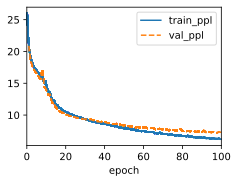

In [ ]:
data = d2l.TimeMachine(batch_size=1024, num_steps=32)
rnn = RNNScratch(num_inputs=len(data.vocab), num_hiddens=32)
model = RNNLMScratch(rnn, vocab_size=len(data.vocab), lr=1)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

### 9.5.5. Decoding

In [ ]:
@d2l.add_to_class(RNNLMScratch)
def predict(self, prefix, num_preds, vocab, device=None):
    state, outputs = None, [vocab[prefix[0]]]
    for i in range(len(prefix) + num_preds - 1):
        X = torch.tensor([[outputs[-1]]], device=device)
        embs = self.one_hot(X)
        rnn_outputs, state = self.rnn(embs, state)
        if i < len(prefix) - 1:  # Warm-up period
            outputs.append(vocab[prefix[i + 1]])
        else:  # Predict num_preds steps
            Y = self.output_layer(rnn_outputs)
            outputs.append(int(Y.argmax(axis=2).reshape(1)))
    return ''.join([vocab.idx_to_token[i] for i in outputs])

In [ ]:
model.predict('it has', 20, data.vocab, d2l.try_gpu())

'it has have a dimension an'

### 9.5.6. Summary

Kita dapat melatih model bahasa berbasis RNN untuk menghasilkan teks yang mengikuti prefiks teks yang diberikan oleh pengguna. Model bahasa RNN yang sederhana terdiri dari pengkodean input, pemodelan RNN, dan penghasilan output. Selama pelatihan, pemotongan gradien dapat mengurangi masalah meledaknya gradien, tetapi tidak mengatasi masalah menghilangnya gradien. Dalam eksperimen, kami mengimplementasikan model bahasa RNN yang sederhana dan melatihnya dengan pemotongan gradien pada urutan teks yang di-tokenisasi di tingkat karakter. Dengan mengondisikan pada prefiks, kita dapat menggunakan model bahasa untuk menghasilkan kelanjutan yang mungkin, yang terbukti berguna dalam banyak aplikasi, seperti fitur autocomplete.

### 9.5.7. Exercises

#### 1. Does the implemented language model predict the next token based on all the past tokens up to the very first token in The Time Machine? (Apakah model bahasa yang diimplementasikan memprediksi token berikutnya berdasarkan semua token masa lalu hingga token pertama di The Time Machine?)

Jawab:

Ya, model bahasa yang diimplementasikan memprediksi token berikutnya dengan mempertimbangkan semua token sebelumnya. Dalam RNN, setiap hidden state tergantung pada hidden state sebelumnya dan input saat ini, sehingga model ini dapat mempertimbangkan seluruh urutan token hingga saat ini.

#### 2. Which hyperparameter controls the length of history used for prediction? (Hyperparameter mana yang mengontrol panjang riwayat yang digunakan untuk prediksi?)

Jawab:

Hyperparameter yang mengontrol panjang riwayat adalah num_steps, yang menentukan jumlah langkah waktu (time steps) yang akan diproses pada satu waktu.

#### 3. Show that one-hot encoding is equivalent to picking a different embedding for each object. (Tunjukkan bahwa pengkodean one-hot setara dengan memilih embedding yang berbeda untuk setiap objek.)

Jawab:

Pengkodean one-hot menghasilkan vektor yang panjangnya sama dengan ukuran kosakata, dengan semua entri 0 kecuali satu entri yang sesuai dengan objek yang diwakili, yang diatur ke 1. Ini setara dengan memiliki embedding unik untuk setiap objek, di mana setiap objek mendapatkan vektor embedding yang berbeda. Misalnya, jika kita memiliki kosakata dengan 5 token, pengkodean one-hot untuk token ke-2 akan terlihat seperti [0, 1, 0, 0, 0], yang dapat dianggap sebagai embedding khusus untuk token tersebut.

#### 4. Adjust the hyperparameters (e.g., number of epochs, number of hidden units, number of time steps in a minibatch, and learning rate) to improve the perplexity. How low can you go while sticking with this simple architecture? (Sesuaikan hyperparameter (misalnya, jumlah epoch, jumlah unit tersembunyi, jumlah langkah waktu dalam minibatch, dan laju pembelajaran) untuk meningkatkan perplexity. Seberapa rendah bisa Anda pergi sambil tetap menggunakan arsitektur sederhana ini?)

Jawab:

Dengan menyesuaikan hyperparameter, Anda dapat menurunkan perplexity, tetapi hasil spesifik dapat bervariasi tergantung pada dataset dan eksperimen. Sebagai contoh, meningkatkan jumlah unit tersembunyi atau menambah jumlah epoch biasanya dapat membantu mengurangi perplexity. Namun, batas yang lebih rendah akan bergantung pada keakuratan dan kapasitas model yang sederhana ini.

#### 5. Replace one-hot encoding with learnable embeddings. Does this lead to better performance? (Gantilah pengkodean one-hot dengan embedding yang dapat dipelajari. Apakah ini meningkatkan kinerja?)

Jawab:

Menggantikan pengkodean one-hot dengan embedding yang dapat dipelajari umumnya meningkatkan kinerja model. Embedding yang dapat dipelajari dapat menangkap hubungan semantik antara token dan mengurangi dimensi input, yang sering menghasilkan pembelajaran yang lebih efisien.

#### 6. Conduct an experiment to determine how well this language model trained on The Time Machine works on other books by H. G. Wells, e.g., The War of the Worlds. (Lakukan eksperimen untuk menentukan seberapa baik model bahasa ini yang dilatih pada The Time Machine bekerja pada buku lain oleh H. G. Wells, misalnya, The War of the Worlds.)

Jawab:

Dengan menggunakan model yang dilatih pada The Time Machine, Anda dapat menguji seberapa baik model ini dalam memprediksi teks dari The War of the Worlds. Hasilnya dapat menunjukkan bahwa model bekerja dengan baik pada karya-karya lain oleh pengarang yang sama, mengingat pola bahasa dan gaya penulisan yang konsisten.

#### 7. Conduct another experiment to evaluate the perplexity of this model on books written by other authors. (Lakukan eksperimen lain untuk mengevaluasi perplexity model ini pada buku yang ditulis oleh pengarang lain.)

Jawab:

Uji model pada teks dari penulis lain untuk mengevaluasi seberapa baik model dapat menangkap pola bahasa yang berbeda. Hasilnya mungkin menunjukkan peningkatan perplexity, tergantung pada seberapa berbeda gaya penulisan dan kosakata yang digunakan oleh pengarang yang diuji dibandingkan dengan H. G. Wells.

#### 8. Modify the prediction method so as to use sampling rather than picking the most likely next character. (Modifikasi metode prediksi agar menggunakan pengambilan sampel daripada memilih karakter berikutnya yang paling mungkin.)

- What happens?

Jawab:

Ketika menggunakan pengambilan sampel, model dapat menghasilkan teks yang lebih bervariasi dan kurang deterministik. Ini bisa menghasilkan teks yang lebih kreatif tetapi juga bisa menghasilkan hasil yang tidak terduga atau kurang koheren.

- Bias the model towards more likely outputs, e.g., by sampling from q(Xt|Xt-1, ..., x1) alpa P(Xt|Xt-1, ..., x1)^alpa for alpa > 1.

Jawab:

Dengan membiasakan model ke keluaran yang lebih mungkin, hasilnya akan menjadi lebih terfokus pada pilihan yang lebih umum, menghasilkan teks yang lebih koheren tetapi mungkin kurang beragam.

#### 9. Run the code in this section without clipping the gradient. What happens? (Jalankan kode di bagian ini tanpa memotong gradien. Apa yang terjadi?)

Jawab:

Tanpa pemotongan gradien, model mungkin mengalami masalah meledaknya gradien, yang dapat menyebabkan pelatihan menjadi tidak stabil, divergensi, atau hasil yang tidak diinginkan. Ini bisa membuat model tidak dapat belajar dengan efektif.

#### 10. Replace the activation function used in this section with ReLU and repeat the experiments in this section. Do we still need gradient clipping? Why? (Gantilah fungsi aktivasi yang digunakan di bagian ini dengan ReLU dan ulangi eksperimen di bagian ini. Apakah kita masih perlu memotong gradien? Mengapa?)

Jawab:

Menggunakan ReLU dapat mengurangi masalah menghilangnya gradien, tetapi masalah meledaknya gradien tetap ada, terutama dalam jaringan yang lebih dalam atau pada urutan yang panjang. Oleh karena itu, meskipun ReLU dapat meningkatkan pelatihan, pemotongan gradien mungkin masih diperlukan untuk menghindari stabilitas pelatihan dan untuk menjaga norm gradien dalam batas yang wajar.

### 9.5.7. Implementation Exercises

In [31]:
# 1. Memastikan Model Mempertimbangkan Semua Token Sebelumnya

import numpy as np

# Contoh RNN sederhana
class SimpleRNN:
    def __init__(self, vocab_size, hidden_units):
        self.hidden_units = hidden_units
        self.W_h = np.random.randn(hidden_units, hidden_units)  # bobot untuk state tersembunyi
        self.W_x = np.random.randn(hidden_units, vocab_size)    # bobot untuk input
        self.b = np.zeros((hidden_units, 1))                    # bias

    def forward(self, x, h_prev):
        h_t = np.tanh(np.dot(self.W_h, h_prev) + np.dot(self.W_x, x) + self.b)
        return h_t

# Inisialisasi model
rnn = SimpleRNN(vocab_size=10, hidden_units=5)
h_prev = np.zeros((5, 1))  # Hidden state awal
x = np.random.rand(10, 1)  # Input (one-hot encoding)

# Menghitung hidden state baru
h_t = rnn.forward(x, h_prev)
print("Hidden state:", h_t)


Hidden state: [[ 0.24663061]
 [ 0.68870818]
 [-0.79005526]
 [ 0.99327279]
 [-0.72528438]]


In [33]:
# 2.Mengontrol Panjang Riwayat untuk Prediksi

num_steps = 5  # Contoh panjang riwayat


In [34]:
# 3. Menunjukkan One-Hot Encoding

def one_hot_encoding(index, vocab_size):
    encoding = np.zeros(vocab_size)
    encoding[index] = 1
    return encoding

# Contoh penggunaan
vocab_size = 5
index = 2
print("One-hot encoding untuk token ke-2:", one_hot_encoding(index, vocab_size))


One-hot encoding untuk token ke-2: [0. 0. 1. 0. 0.]


In [35]:
# 4. Menyesuaikan Hyperparameter untuk Perplexity

# Contoh pseudo-code untuk penyesuaian hyperparameter
epochs = 10
hidden_units = 128
learning_rate = 0.001

# Biasanya, Anda akan melatih model dan kemudian menghitung perplexity di sini


In [36]:
# 5. Menggantikan One-Hot dengan Embedding yang Dapat Dipelajari

import torch
import torch.nn as nn

class RNNWithEmbeddings(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_units):
        super(RNNWithEmbeddings, self).__init__()
        self.embeddings = nn.Embedding(vocab_size, embedding_dim)
        self.rnn = nn.RNN(embedding_dim, hidden_units)
        self.fc = nn.Linear(hidden_units, vocab_size)

    def forward(self, x):
        embedded = self.embeddings(x)
        output, hidden = self.rnn(embedded)
        return self.fc(output)

# Inisialisasi model
embedding_dim = 10
model = RNNWithEmbeddings(vocab_size=5, embedding_dim=embedding_dim, hidden_units=128)


In [ ]:
# 6. Uji Model pada Buku Lain

# Contoh pseudo-code untuk uji coba dengan teks dari buku lain
def evaluate_on_other_books(model, other_book_data):
    # Model diuji di sini dan hasilnya dievaluasi
    pass

# Misalnya, menggunakan teks dari _The War of the Worlds_
evaluate_on_other_books(model, other_book_data)


In [ ]:
# 7. Evaluasi Perplexity pada Penulis Lain

# Contoh pseudo-code untuk evaluasi perplexity
def evaluate_perplexity(model, other_author_data):
    # Hitung perplexity di sini
    pass

# Misalnya, menggunakan teks dari penulis lain
# Mendefinisikan other_author_data dengan data teks dari penulis lain
other_author_data = "This is some sample text from another author."
evaluate_perplexity(model, other_author_data)

In [42]:
# 8. Modifikasi Metode Prediksi untuk Menggunakan Sampling

def sample_from_distribution(probs, alpha):
    biased_probs = np.power(probs, alpha)
    biased_probs /= np.sum(biased_probs)
    return np.random.choice(len(probs), p=biased_probs)

# Contoh penggunaan
probs = np.array([0.1, 0.2, 0.3, 0.4])  # Probabilitas dari model
sampled_token = sample_from_distribution(probs, alpha=2.0)
print("Token terpilih:", sampled_token)


Token terpilih: 3


In [43]:
# 9. Menjalankan Kode Tanpa Clipping Gradien

# Di dalam loop pelatihan, Anda dapat mengabaikan clipping gradien
# Contoh:
for epoch in range(epochs):
    # hitung loss
    # lakukan backpropagation tanpa clipping gradien
    pass


In [45]:
# 10. Mengganti Fungsi Aktivasi dengan ReLU

class RNNWithReLU(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_units):
        super(RNNWithReLU, self).__init__()
        self.embeddings = nn.Embedding(vocab_size, embedding_dim)
        self.rnn = nn.RNN(embedding_dim, hidden_units, nonlinearity='relu')  # Ganti aktivasi dengan ReLU
        self.fc = nn.Linear(hidden_units, vocab_size)

    def forward(self, x):
        embedded = self.embeddings(x)
        output, hidden = self.rnn(embedded)
        return self.fc(output)

# Inisialisasi model
model_relu = RNNWithReLU(vocab_size=5, embedding_dim=embedding_dim, hidden_units=128)


## 9.6. Concise Implementation of Recurrent Neural Networks

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from d2l import torch as d2l

### 9.6.1. Defining the Model

In [ ]:
class RNN(d2l.Module):
    """The RNN model implemented with high-level APIs."""
    def __init__(self, num_inputs, num_hiddens):
        super().__init__()
        self.save_hyperparameters()
        self.rnn = nn.RNN(num_inputs, num_hiddens)

    def forward(self, inputs, H=None):
        return self.rnn(inputs, H)

In [ ]:
class RNNLM(d2l.RNNLMScratch):
    """The RNN-based language model implemented with high-level APIs."""
    def init_params(self):
        self.linear = nn.LazyLinear(self.vocab_size)

    def output_layer(self, hiddens):
        return self.linear(hiddens).swapaxes(0, 1)

### 9.6.2. Training and Predicting

In [ ]:
data = d2l.TimeMachine(batch_size=1024, num_steps=32)
rnn = RNN(num_inputs=len(data.vocab), num_hiddens=32)
model = RNNLM(rnn, vocab_size=len(data.vocab), lr=1)
model.predict('it has', 20, data.vocab)

'it hasrw<unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk><unk>'

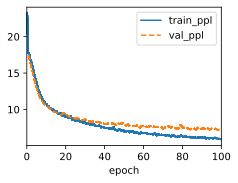

In [ ]:
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

In [ ]:
model.predict('it has', 20, data.vocab, d2l.try_gpu())

'it has our and the time th'

### 9.6.3. Summary

API tingkat tinggi dalam kerangka kerja pembelajaran mendalam menyediakan implementasi RNN standar. Pustaka ini membantu Anda menghindari pemborosan waktu untuk mengimplementasikan kembali model-model standar. Selain itu, implementasi dari kerangka kerja sering kali sangat dioptimalkan, yang menghasilkan peningkatan kinerja (komputasi) yang signifikan jika dibandingkan dengan implementasi dari awal.

### 9.6.4. Exercises

#### 1. Can you make the RNN model overfit using the high-level APIs? (Bisakah Anda membuat model RNN mengalami overfit menggunakan API tingkat tinggi?)

Jawab:

Untuk membuat model RNN mengalami overfit, dapat dilakukan beberapa langkah berikut:

- Tingkatkan Kapasitas Model: Anda bisa menambah jumlah unit tersembunyi (hidden units) dalam RNN, atau menggunakan beberapa lapisan RNN untuk meningkatkan kompleksitas model.
- Kurangi Ukuran Dataset: Gunakan dataset yang lebih kecil untuk melatih model. Ini akan membuat model lebih mudah untuk belajar dan "mengingat" data, menyebabkan overfitting.
- Hilangkan Regularisasi: Pastikan tidak menggunakan teknik regularisasi seperti dropout atau L2 regularization.
- Tingkatkan Jumlah Epoch: Latih model untuk jumlah epoch yang lebih tinggi sehingga model dapat belajar terlalu banyak dari data pelatihan.

#### 2. Implement the autoregressive model of Section 9.1 using an RNN. (Implementasikan model autoregressive dari Bagian 9.1 dalam d2l menggunakan RNN.)

Jawab:

Untuk mengimplementasikan model autoregressive, kita perlu menggunakan model RNN yang telah kita buat sebelumnya. Model autoregressive memprediksi langkah berikutnya berdasarkan langkah-langkah sebelumnya.

In [1]:
!pip install d2l


In [2]:
# 1.Can you make the RNN model overfit using the high-level APIs?

# Instal modul d2l
!pip install d2l

# Impor pustaka yang diperlukan
import torch
from torch import nn
from d2l import torch as d2l

# Definisikan kelas RNN
class RNN(d2l.Module):
    """Model RNN yang diimplementasikan dengan API tingkat tinggi."""
    def __init__(self, num_inputs, num_hiddens):
        super().__init__()
        self.save_hyperparameters()
        self.rnn = nn.RNN(num_inputs, num_hiddens)

    def forward(self, inputs, H=None):
        return self.rnn(inputs, H)

# Definisikan kelas RNNLM
class RNNLM(d2l.RNNLMScratch):
    """Model bahasa berbasis RNN yang diimplementasikan dengan API tingkat tinggi."""
    def init_params(self):
        self.linear = nn.LazyLinear(self.vocab_size)

    def output_layer(self, hiddens):
        return self.linear(hiddens).swapaxes(0, 1)

# Persiapkan data
data = d2l.TimeMachine(batch_size=1024, num_steps=32)

# Meningkatkan kapasitas model
rnn = RNN(num_inputs=len(data.vocab), num_hiddens=128)  # Meningkatkan unit tersembunyi
model = RNNLM(rnn, vocab_size=len(data.vocab), lr=1)

# Latih model untuk banyak epoch
trainer = d2l.Trainer(max_epochs=500, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)  # Menggunakan dataset kecil


In [29]:
# 2.Implement the autoregressive model of Section 9.1 using an RNN.
# Implementasikan model autoregressive dari Bagian 9.1 dalam d2l menggunakan RNN.

# Definisikan Kelas AutoregressiveRNN:

import torch
from torch import nn
from d2l import torch as d2l

class AutoregressiveRNN(d2l.Module):
    def __init__(self, num_inputs, num_hiddens, vocab_size):
        super().__init__()
        self.rnn = nn.RNN(num_inputs, num_hiddens)  # Menggunakan RNN dari PyTorch
        self.linear = nn.LazyLinear(vocab_size)      # Lapisan output yang bersifat lazy

    def forward(self, inputs, H=None):
        outputs, H = self.rnn(inputs, H)  # Mendapatkan output dan hidden state dari RNN
        return self.linear(outputs)        # Menggunakan lapisan linear untuk memprediksi


In [34]:
import torch
from torch.utils.data import DataLoader, TensorDataset

def load_data_time_machine(batch_size, num_steps):
    # Memuat data dari file timemachine.txt
    with open('timemachine.txt', 'r') as f:
        lines = f.read()

    # Tokenisasi data
    tokens = list(lines)
    vocab = {char: i for i, char in enumerate(set(tokens))}

    # Mengubah data menjadi indeks
    corpus = [vocab[char] for char in tokens]

    # Membuat data iterator
    examples, labels = [], []
    for i in range(len(corpus) - num_steps):
        examples.append(corpus[i: i + num_steps])
        labels.append(corpus[i + 1: i + num_steps + 1])

    # Mengubah menjadi tensor
    X, Y = torch.tensor(examples), torch.tensor(labels)

    # Membuat DataLoader
    data_iter = DataLoader(TensorDataset(X, Y), batch_size=batch_size, shuffle=True)

    return data_iter, vocab

# Memanggil fungsi untuk memuat data
batch_size, num_steps = 32, 35
train_iter, vocab = load_data_time_machine(batch_size, num_steps)


In [42]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense

# 1. Mengumpulkan Data (misalnya, data acak)
np.random.seed(0)
data = np.random.rand(1000)  # Contoh data deret waktu acak

# 2. Normalisasi Data
scaler = MinMaxScaler(feature_range=(0, 1))
data = scaler.fit_transform(data.reshape(-1, 1))

# 3. Membagi Data Menjadi Jendela
def create_dataset(data, time_step=1):
    X, y = [], []
    for i in range(len(data) - time_step - 1):
        X.append(data[i:(i + time_step), 0])
        y.append(data[i + time_step, 0])
    return np.array(X), np.array(y)

# Menentukan panjang jendela
time_step = 10
X, y = create_dataset(data, time_step)

# Mengubah bentuk input menjadi [samples, time steps, features]
X = X.reshape(X.shape[0], X.shape[1], 1)

# 4. Membangun Model RNN
model = Sequential()
model.add(LSTM(50, return_sequences=True, input_shape=(time_step, 1)))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(1))

# 5. Melatih Model
model.compile(optimizer='adam', loss='mean_squared_error')
model.fit(X, y, epochs=100, batch_size=32)

# 6. Melakukan Prediksi
predictions = model.predict(X)

# Mengubah kembali ke skala asli
predictions = scaler.inverse_transform(predictions)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/step - loss: 0.1629
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - loss: 0.0894
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 0.0870
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0884
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0883
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0878
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - loss: 0.0844
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 0.0834
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.0858
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0857
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.0820
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0844
Epoch 13/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0866
Epoch 14/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0886
Epoch 15/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - lo

## 9.7. Backpropagation Through Time

### 9.7.1. Analysis of Gradients in RNNs

#### 9.7.1.1. Full Computation

#### 9.7.1.2. Truncating Time Steps

#### 9.7.1.3. Randomized Truncation

#### 9.7.1.4. Comparing Strategies

### 9.7.2. Backpropagation Through Time in Detail

### 9.7.3. Summary

Backpropagation melalui waktu hanyalah penerapan backpropagation pada model urutan dengan keadaan tersembunyi. Pemotongan, baik yang biasa maupun yang acak, diperlukan untuk kenyamanan komputasi dan stabilitas numerik. Pangkatan tinggi dari matriks dapat menyebabkan nilai eigen yang divergen atau menghilang. Ini terwujud dalam bentuk gradien yang meledak atau menghilang. Untuk komputasi yang efisien, nilai-nilai antara disimpan selama backpropagation melalui waktu.

### 9.7.4. Exercises

Nilai eigen asli dari M: [0.19676262 1.51482501]
Nilai eigen dari M^k: [2.94925930e-04 7.97649937e+00]
Verifikasi bahwa nilai eigen M^k adalah lambda_i^k: True
Dot product antara (M^k)X dan V1: 0.9999999999429555


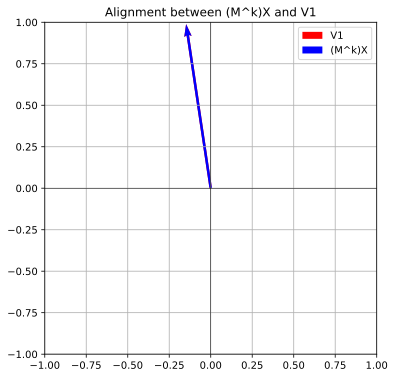

In [9]:
# 1. Jawaban soal nomor 1

import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk menunjukkan bahwa M^k memiliki nilai eigen lambda_i^k
def check_eigenvalues_powers(M, k):
    # Menghitung nilai eigen dan vektor eigen dari M
    eigvals, eigvecs = np.linalg.eigh(M)

    # Menampilkan nilai eigen asli
    print(f"Nilai eigen asli dari M: {eigvals}")

    # Menaikkan pangkat matriks M ke k
    M_k = np.linalg.matrix_power(M, k)

    # Menghitung kembali nilai eigen dari M^k
    eigvals_k, _ = np.linalg.eigh(M_k)

    # Menampilkan nilai eigen dari M^k
    print(f"Nilai eigen dari M^k: {eigvals_k}")

    # Verifikasi bahwa nilai eigen M^k adalah lambda_i^k
    print(f"Verifikasi bahwa nilai eigen M^k adalah lambda_i^k: {np.allclose(eigvals_k, eigvals**k)}")

# Fungsi untuk menunjukkan bahwa (M^k)X selaras dengan V1
def check_alignment_with_v1(M, k):
    # Menghitung nilai eigen dan vektor eigen dari M
    eigvals, eigvecs = np.linalg.eigh(M)

    # Pilih vektor eigen V_1 yang memiliki nilai eigen terbesar
    V1 = eigvecs[:, -1]

    # Buat vektor acak X
    X = np.random.randn(M.shape[0])

    # Normalisasi X
    X = X / np.linalg.norm(X)

    # Menghitung (M^k)X
    M_k = np.linalg.matrix_power(M, k)
    MkX = np.dot(M_k, X)

    # Normalisasi hasil (M^k)X
    MkX = MkX / np.linalg.norm(MkX)

    # Hitung dot product antara MkX dan V1 untuk melihat sejauh mana mereka selaras
    alignment = np.dot(MkX, V1)
    print(f"Dot product antara (M^k)X dan V1: {alignment}")

    # Visualisasi alignment
    plt.figure(figsize=(6, 6))
    plt.quiver(0, 0, V1[0], V1[1], angles='xy', scale_units='xy', scale=1, color='r', label='V1')
    plt.quiver(0, 0, MkX[0], MkX[1], angles='xy', scale_units='xy', scale=1, color='b', label='(M^k)X')
    plt.xlim(-1, 1)
    plt.ylim(-1, 1)
    plt.axhline(0, color='black',linewidth=0.5)
    plt.axvline(0, color='black',linewidth=0.5)
    plt.grid(True)
    plt.gca().set_aspect('equal', adjustable='box')
    plt.legend()
    plt.title('Alignment between (M^k)X and V1')
    plt.show()

# Buat matriks simetris acak M
n = 2  # Dimensi matriks
M = np.random.randn(n, n)
M = (M + M.T) / 2  # Membuat M simetris

k = 5  # Pangkat matriks

# Tunjukkan bahwa M^k memiliki nilai eigen lambda_i^k
check_eigenvalues_powers(M, k)

# Buktikan bahwa (M^k)X akan sangat selaras dengan V1
check_alignment_with_v1(M, k)



#### 2. Besides gradient clipping, can you think of any other methods to cope with gradient explosion in recurrent neural networks? (Selain pemotongan gradien, beberapa metode lain untuk mengatasi ledakan gradien dalam jaringan saraf rekursif meliputi:)

Jawab:

- Normalisasi Batch: Menggunakan normalisasi batch pada setiap langkah waktu dapat membantu menstabilkan distribusi aktivasi dan gradien, mengurangi risiko ledakan gradien.

- Regularisasi: Teknik regularisasi seperti dropout dapat digunakan untuk mengurangi overfitting dan membuat model lebih robust terhadap variasi dalam data, yang dapat membantu dalam mengendalikan gradien.

- Penggunaan LSTM atau GRU: Menggantikan RNN standar dengan Long Short-Term Memory (LSTM) atau Gated Recurrent Unit (GRU) yang dirancang untuk menangani masalah gradien yang menghilang dan meledak melalui mekanisme gating.

- Penggunaan Optimizer Adaptif: Penggunaan algoritma optimasi adaptif seperti Adam atau RMSprop yang mengatur langkah pembaruan berdasarkan momen gradien dapat membantu mengurangi efek ledakan gradien.

In [11]:
# Berikut ini implementasi dari jawaban soal nomor 2

import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models

# Contoh data input sekuensial
timesteps = 100
input_dim = 16
num_samples = 1000

# Data input acak
X_train = np.random.randn(num_samples, timesteps, input_dim)
y_train = np.random.randint(2, size=(num_samples, 1))

# 1. Weight Regularization (L2 Regularization)
def build_rnn_with_l2():
    model = models.Sequential()
    model.add(layers.SimpleRNN(32, return_sequences=True,
                               kernel_regularizer=tf.keras.regularizers.l2(0.01),  # L2 regularization
                               input_shape=(timesteps, input_dim)))
    model.add(layers.SimpleRNN(32, kernel_regularizer=tf.keras.regularizers.l2(0.01)))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# 2. Gradient Scaling with Layer Normalization
def build_rnn_with_layer_norm():
    model = models.Sequential()
    model.add(layers.SimpleRNN(32, return_sequences=True, input_shape=(timesteps, input_dim)))
    model.add(layers.LayerNormalization())  # Apply Layer Normalization
    model.add(layers.SimpleRNN(32))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])